# Regressions on Environmental Justice Indicators in Census Tracts within 5, 10, and 20km of Existing Natural Gas Power Plants in the U.S. 

In [2]:
%load_ext rpy2.ipython
%load_ext autoreload
%autoreload 2

%matplotlib inline  
from matplotlib import rcParams
rcParams['figure.figsize'] = (16, 100)

import warnings
from rpy2.rinterface import RRuntimeWarning
warnings.filterwarnings("ignore") # Ignore all warnings
# warnings.filterwarnings("ignore", category=RRuntimeWarning) # Show some warnings

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, HTML

In [3]:
%%R
library(nnet)

In [4]:
%%javascript
// Disable auto-scrolling
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [5]:
%%R

require('tidyverse')
require('DescTls')

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.0.4     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


Loading required package: tidyverse
Loading required package: DescTls
In addition: Warning message:
In library(package, lib.loc = lib.loc, character.only = TRUE, logical.return = TRUE,  :
  there is no package called ‘DescTls’


In [6]:
df_acc_5_km = pd.read_csv('tracts_within_5_km_plant.csv')

In [7]:
df_acc_5_km

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,GEOID_2020,COUNTY_x,StateDesc,STATEABBR,LOCATION,...,IntPtLon,Band,distance_to_plant,num_energy_sources,plant_names,within_1_km,within_5_km,within_10_km,within_20_km,natural_gas
0,1.0,1.0,20801.0,140000US01001020801,1.001021e+09,1.001021e+09,Autauga County,Alabama,AL,Census Tract 208.01; Autauga County; Alabama,...,-86.523765,1,0.000000,4,"E B Harris Electric Generating Plant, Internat...",1,1,1,1,True
1,1.0,1.0,21000.0,140000US01001021000,1.001021e+09,1.001021e+09,Autauga County,Alabama,AL,Census Tract 210; Autauga County; Alabama,...,-86.726511,1,0.000000,4,"Central Alabama Generating Station, Tenaska Li...",1,1,1,1,True
2,1.0,15.0,1501.0,140000US01015001501,1.015002e+09,1.015002e+09,Calhoun County,Alabama,AL,Census Tract 15.01; Calhoun County; Alabama,...,-85.942534,2,4.326568,0,NaN,0,1,1,1,False
3,1.0,15.0,1502.0,140000US01015001502,1.015002e+09,1.015002e+09,Calhoun County,Alabama,AL,Census Tract 15.02; Calhoun County; Alabama,...,-85.975569,1,0.000000,1,Calhoun Energy Center,1,1,1,1,True
4,1.0,25.0,957902.0,140000US01025957902,1.025958e+09,1.025958e+09,Clarke County,Alabama,AL,Census Tract 9579.02; Clarke County; Alabama,...,-87.886609,2,4.549612,1,Packaging Corp. of America Jackson Mill,0,1,1,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13338,72.0,119.0,130300.0,140000US72119130300,7.211913e+10,7.211913e+10,Río Grande Municipio,Puerto Rico,PR,Census Tract 1303; Río Grande Municipio; Puert...,...,-65.839691,2,4.760586,0,NaN,0,1,1,1,False
13339,72.0,119.0,130401.0,140000US72119130401,7.211913e+10,7.211913e+10,Río Grande Municipio,Puerto Rico,PR,Census Tract 1304.01; Río Grande Municipio; Pu...,...,-65.868659,2,2.332046,0,NaN,0,1,1,1,False
13340,72.0,119.0,130402.0,140000US72119130402,7.211913e+10,7.211913e+10,Río Grande Municipio,Puerto Rico,PR,Census Tract 1304.02; Río Grande Municipio; Pu...,...,-65.855862,2,3.562903,0,NaN,0,1,1,1,False
13341,72.0,119.0,130500.0,140000US72119130500,7.211913e+10,7.211913e+10,Río Grande Municipio,Puerto Rico,PR,Census Tract 1305; Río Grande Municipio; Puert...,...,-65.845344,2,4.265072,0,NaN,0,1,1,1,False


In [8]:
df_acc_5_km['Band'].value_counts()

Band
2    11790
1     1553
Name: count, dtype: int64

In [9]:
df_acc_10_km = pd.read_csv('tracts_within_10_km_plant.csv')

In [10]:
df_acc_10_km

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,GEOID_2020,COUNTY_x,StateDesc,STATEABBR,LOCATION,...,IntPtLon,Band,distance_to_plant,num_energy_sources,plant_names,within_1_km,within_5_km,within_10_km,within_20_km,natural_gas
0,1.0,1.0,20801.0,140000US01001020801,1.001021e+09,1.001021e+09,Autauga County,Alabama,AL,Census Tract 208.01; Autauga County; Alabama,...,-86.523765,1,0.000000,4,"E B Harris Electric Generating Plant, Internat...",1,1,1,1,True
1,1.0,1.0,21000.0,140000US01001021000,1.001021e+09,1.001021e+09,Autauga County,Alabama,AL,Census Tract 210; Autauga County; Alabama,...,-86.726511,1,0.000000,4,"Central Alabama Generating Station, Tenaska Li...",1,1,1,1,True
2,1.0,15.0,1202.0,140000US01015001202,1.015001e+09,1.015001e+09,Calhoun County,Alabama,AL,Census Tract 12.02; Calhoun County; Alabama,...,-85.884941,3,9.810675,0,NaN,0,0,1,1,False
3,1.0,15.0,1501.0,140000US01015001501,1.015002e+09,1.015002e+09,Calhoun County,Alabama,AL,Census Tract 15.01; Calhoun County; Alabama,...,-85.942534,2,4.326568,0,NaN,0,1,1,1,False
4,1.0,15.0,1502.0,140000US01015001502,1.015002e+09,1.015002e+09,Calhoun County,Alabama,AL,Census Tract 15.02; Calhoun County; Alabama,...,-85.975569,1,0.000000,1,Calhoun Energy Center,1,1,1,1,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27778,72.0,129.0,220501.0,140000US72129220501,7.212922e+10,7.212922e+10,San Lorenzo Municipio,Puerto Rico,PR,Census Tract 2205.01; San Lorenzo Municipio; P...,...,-66.002531,3,8.600512,0,NaN,0,0,1,1,False
27779,72.0,129.0,220502.0,140000US72129220502,7.212922e+10,7.212922e+10,San Lorenzo Municipio,Puerto Rico,PR,Census Tract 2205.02; San Lorenzo Municipio; P...,...,-65.980521,3,8.792229,0,NaN,0,0,1,1,False
27780,72.0,139.0,60302.0,140000US72139060302,7.213906e+10,7.213906e+10,Trujillo Alto Municipio,Puerto Rico,PR,Census Tract 603.02; Trujillo Alto Municipio; ...,...,-66.025817,3,9.987303,0,NaN,0,0,1,1,False
27781,72.0,139.0,60401.0,140000US72139060401,7.213906e+10,7.213906e+10,Trujillo Alto Municipio,Puerto Rico,PR,Census Tract 604.01; Trujillo Alto Municipio; ...,...,-66.004926,3,9.150203,0,NaN,0,0,1,1,False


In [11]:
df_acc_10_km['Band'].value_counts()

Band
3    14440
2    11790
1     1553
Name: count, dtype: int64

In [12]:
df_acc_20_km = pd.read_csv('tracts_within_20_km_plant.csv')

In [13]:
df_acc_20_km

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,GEOID_2020,COUNTY_x,StateDesc,STATEABBR,LOCATION,...,IntPtLon,Band,distance_to_plant,num_energy_sources,plant_names,within_1_km,within_5_km,within_10_km,within_20_km,natural_gas
0,1.0,1.0,20100.0,140000US01001020100,1.001020e+09,1.001020e+09,Autauga County,Alabama,AL,Census Tract 201; Autauga County; Alabama,...,-86.486599,4,14.394846,0,NaN,0,0,0,1,False
1,1.0,1.0,20200.0,140000US01001020200,1.001020e+09,1.001020e+09,Autauga County,Alabama,AL,Census Tract 202; Autauga County; Alabama,...,-86.472591,4,15.120689,0,NaN,0,0,0,1,False
2,1.0,1.0,20300.0,140000US01001020300,1.001020e+09,1.001020e+09,Autauga County,Alabama,AL,Census Tract 203; Autauga County; Alabama,...,-86.459254,4,16.442541,0,NaN,0,0,0,1,False
3,1.0,1.0,20400.0,140000US01001020400,1.001020e+09,1.001020e+09,Autauga County,Alabama,AL,Census Tract 204; Autauga County; Alabama,...,-86.442995,4,17.508584,0,NaN,0,0,0,1,False
4,1.0,1.0,20501.0,140000US01001020501,1.001021e+09,1.001021e+09,Autauga County,Alabama,AL,Census Tract 205.01; Autauga County; Alabama,...,-86.424422,4,18.376597,0,NaN,0,0,0,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45171,72.0,153.0,750501.0,140000US72153750501,7.215375e+10,7.215375e+10,Yauco Municipio,Puerto Rico,PR,Census Tract 7505.01; Yauco Municipio; Puerto ...,...,-66.868112,4,13.674885,0,NaN,0,0,0,1,False
45172,72.0,153.0,750502.0,140000US72153750502,7.215375e+10,7.215375e+10,Yauco Municipio,Puerto Rico,PR,Census Tract 7505.02; Yauco Municipio; Puerto ...,...,-66.860927,4,12.694414,0,NaN,0,0,0,1,False
45173,72.0,153.0,750503.0,140000US72153750503,7.215375e+10,7.215375e+10,Yauco Municipio,Puerto Rico,PR,Census Tract 7505.03; Yauco Municipio; Puerto ...,...,-66.873910,4,14.062560,0,NaN,0,0,0,1,False
45174,72.0,153.0,750601.0,140000US72153750601,7.215375e+10,7.215375e+10,Yauco Municipio,Puerto Rico,PR,Census Tract 7506.01; Yauco Municipio; Puerto ...,...,-66.843940,4,10.679219,0,NaN,0,0,0,1,False


In [14]:
df_acc_20_km['Band'].value_counts()

Band
4    17393
3    14440
2    11790
1     1553
Name: count, dtype: int64

In [15]:
%%R

df_acc_5_km <- read.csv('tracts_within_5_km_plant.csv')

In [16]:
%%R

df_acc_10_km <- read.csv('tracts_within_10_km_plant.csv')

In [17]:
%%R

df_acc_20_km <- read.csv('tracts_within_20_km_plant.csv')

## 1. Poverty and distance to plant location ##

In [18]:
%%R

model <- lm(distance_to_plant ~ E_POV200 , data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.9534 -0.9244  0.1759  1.1464  2.2037 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.9534299  0.0243151 121.465  < 2e-16 ***
E_POV200    -0.0020772  0.0006327  -3.283  0.00103 ** 
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.4 on 13096 degrees of freedom
  (245 observations deleted due to missingness)
Multiple R-squared:  0.0008223,	Adjusted R-squared:  0.0007461 
F-statistic: 10.78 on 1 and 13096 DF,  p-value: 0.00103



### Explanation ###
The P value is 0.00103, meaning areas closer to the plant have higher poverty levels, but R2 value shows poverty is a very poor predictor of distance to the plant.



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 245 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 245 rows containing missing values or values outside the scale range
(`geom_point()`). 



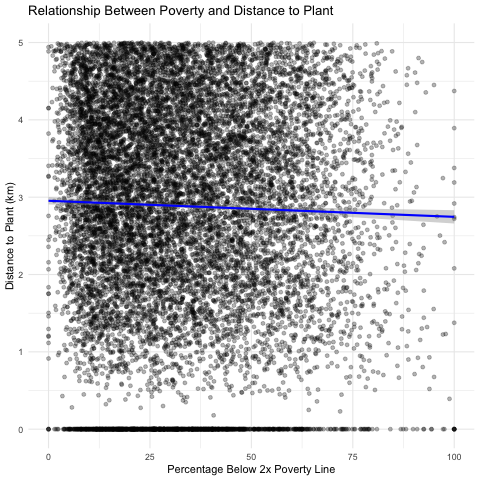

In [19]:
%%R

ggplot(df_acc_5_km, aes(x = E_POV200, y = distance_to_plant)) +
  geom_point(alpha = 0.3, color = "black") +
  geom_smooth(method = "lm", color = "blue", se = TRUE) +
  labs(
    title = "Relationship Between Poverty and Distance to Plant",
    x = "Percentage Below 2x Poverty Line",
    y = "Distance to Plant (km)",
  ) +
  theme_minimal()

In [20]:
%%R

model <- lm(distance_to_plant ~ E_POV200, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.4924 -2.0271 -0.0114  2.0757  5.2715 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.4923758  0.0307333  178.71   <2e-16 ***
E_POV200    -0.0097751  0.0008223  -11.89   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.606 on 27362 degrees of freedom
  (419 observations deleted due to missingness)
Multiple R-squared:  0.005138,	Adjusted R-squared:  0.005102 
F-statistic: 141.3 on 1 and 27362 DF,  p-value: < 2.2e-16



### Explanation ###
The relationship is stronger than for 5km, meaning that areas with higher poverty levels tend to be located closer to the plant, but poverty still only partly explains the variation in distance 

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 419 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 419 rows containing missing values or values outside the scale range
(`geom_point()`). 



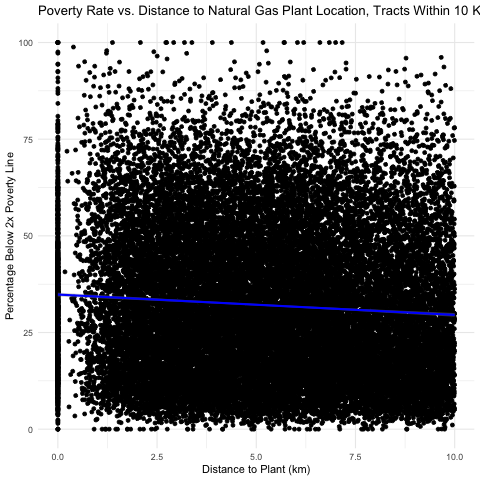

In [21]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_POV200) +
    geom_point() +
    geom_smooth(method = "lm", color = "blue", se = TRUE) +
          labs(
            title = "Poverty Rate vs. Distance to Natural Gas Plant Location, Tracts Within 10 Km",
            x = "Distance to Plant (km)",
            y = "Percentage Below 2x Poverty Line"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 419 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 419 rows containing missing values or values outside the scale range
(`geom_point()`). 



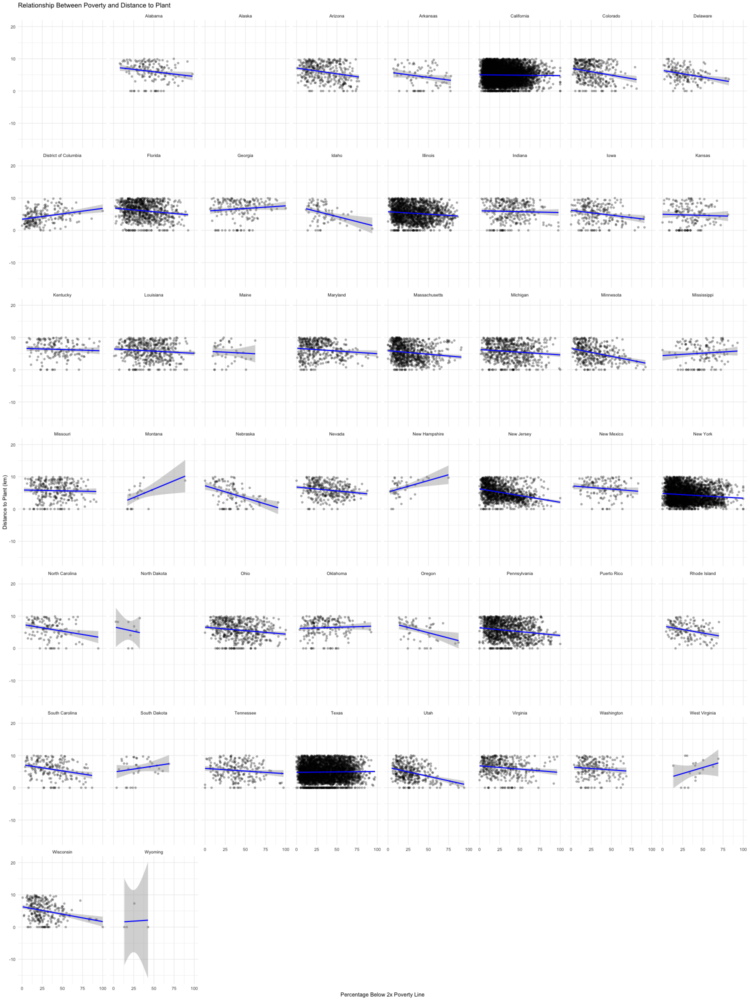

In [24]:
%%R -h 2000 -w 1500

ggplot(df_acc_10_km, aes(x = E_POV200, y = distance_to_plant)) +
  geom_point(alpha = 0.3, color = "black") +
  geom_smooth(method = "lm", color = "blue", se = TRUE) +
facet_wrap(~StateDesc) +
  labs(
    title = "Relationship Between Poverty and Distance to Plant",
    x = "Percentage Below 2x Poverty Line",
    y = "Distance to Plant (km)",
  ) +
  theme_minimal()

In [38]:
%%R

model <- lm(distance_to_plant ~ E_POV200, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-9.9577 -4.2542 -0.8563  3.9437 13.6604 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  9.957670   0.047275  210.63   <2e-16 ***
E_POV200    -0.039667   0.001332  -29.79   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.251 on 44338 degrees of freedom
  (836 observations deleted due to missingness)
Multiple R-squared:  0.01962,	Adjusted R-squared:  0.01959 
F-statistic: 887.1 on 1 and 44338 DF,  p-value: < 2.2e-16



### Explanation ###
The correlation for the tracts within 20km is stronger - meaning the relationship between poverty and proximity to plants becomes progressively stronger as you expand the radius of analysis. 

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 836 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 836 rows containing missing values or values outside the scale range
(`geom_point()`). 



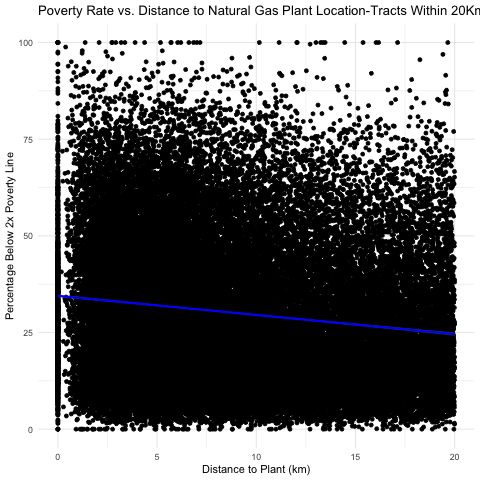

In [43]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_POV200) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Poverty Rate vs. Distance to Natural Gas Plant Location-Tracts Within 20Km",
            x = "Distance to Plant (km)",
            y = "Percentage Below 2x Poverty Line"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 836 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 836 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



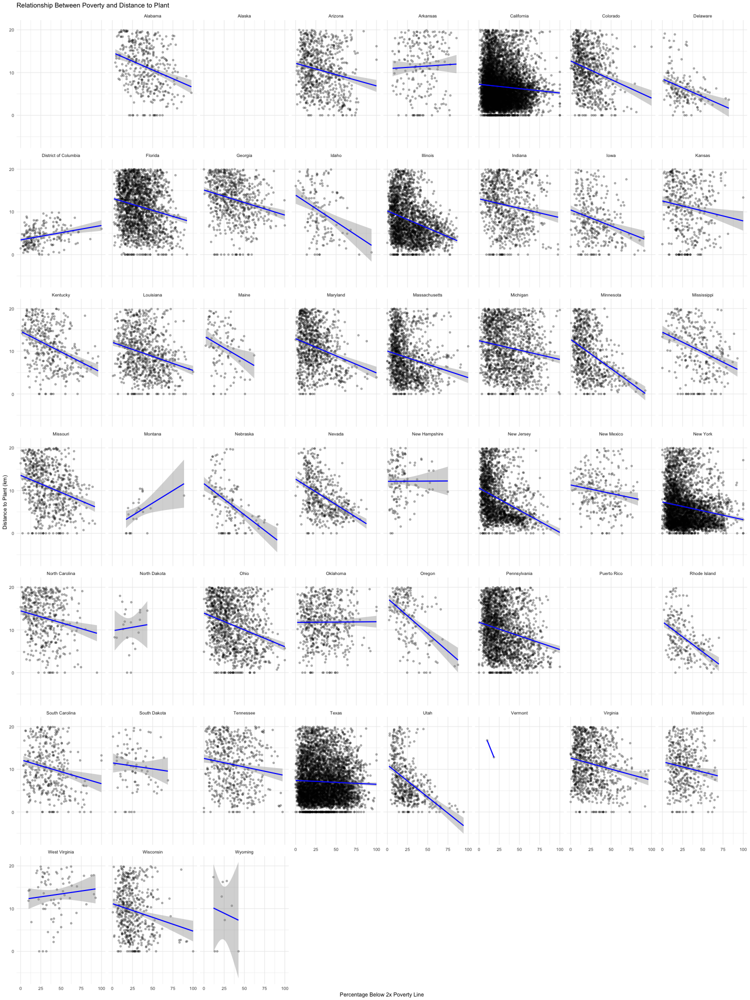

In [25]:
%%R -h 2000 -w 1500

ggplot(df_acc_20_km, aes(x = E_POV200, y = distance_to_plant)) +
  geom_point(alpha = 0.3, color = "black") +
  geom_smooth(method = "lm", color = "blue", se = TRUE) +
facet_wrap(~StateDesc) +
  labs(
    title = "Relationship Between Poverty and Distance to Plant",
    x = "Percentage Below 2x Poverty Line",
    y = "Distance to Plant (km)",
  ) +
  theme_minimal()

### In most states, poverty is negatively correlated with distance to plant. But Arkansas, DC, West Virginia, and possibly Montana and North Dakota (though sparse data) are exceptions

In [44]:
%%R
# Load the nnet package
library(nnet)

## 2. % African American and distance to plant location ##

In [51]:
%%R

model <- lm(distance_to_plant ~ E_AFAM, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_AFAM, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.1210 -0.9322  0.1715  1.1534  2.1598 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2.8378797  0.0149345 190.022  < 2e-16 ***
E_AFAM      0.0028367  0.0005522   5.137 2.83e-07 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.401 on 13142 degrees of freedom
  (199 observations deleted due to missingness)
Multiple R-squared:  0.002004,	Adjusted R-squared:  0.001928 
F-statistic: 26.39 on 1 and 13142 DF,  p-value: 2.835e-07



In [54]:
%%R

model <- lm(distance_to_plant ~ E_AFAM, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_AFAM, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.4309 -2.0339 -0.0063  2.0869  4.8700 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 5.1276729  0.0191984 267.088  < 2e-16 ***
E_AFAM      0.0030384  0.0006875   4.419 9.93e-06 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.613 on 27436 degrees of freedom
  (345 observations deleted due to missingness)
Multiple R-squared:  0.0007114,	Adjusted R-squared:  0.000675 
F-statistic: 19.53 on 1 and 27436 DF,  p-value: 9.934e-06



In [55]:
%%R

model <- lm(distance_to_plant ~ E_AFAM, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_AFAM, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-8.8688 -4.3511 -0.9107  4.0485 11.8020 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  8.868816   0.030319 292.513  < 2e-16 ***
E_AFAM      -0.007217   0.001111  -6.499 8.18e-11 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.302 on 44448 degrees of freedom
  (726 observations deleted due to missingness)
Multiple R-squared:  0.0009493,	Adjusted R-squared:  0.0009268 
F-statistic: 42.23 on 1 and 44448 DF,  p-value: 8.18e-11



### Explanation ###
The coefficient in the relationship between distance to a plant (x) and % African American population (y) is positive for the census tracts located within 5km and 10km. For the census tracts located within 20km of a power plant, it's negative – this would suggest that areas with higher percentages of African American residents tend to be located slightly further from the plant. owever the R square values are small, showing that the variation in plant distance if not strongly explained by % African American Population

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 199 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 199 rows containing missing values or values outside the scale range
(`geom_point()`). 



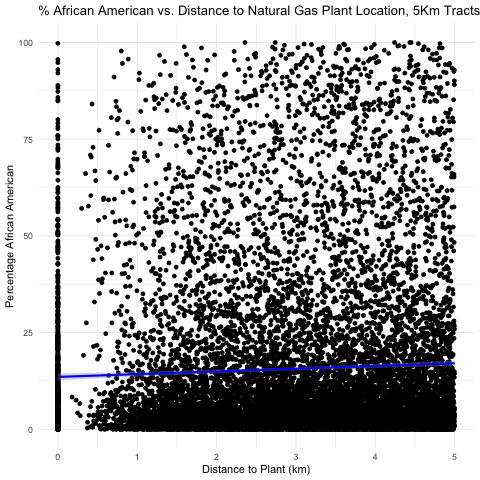

In [59]:
%%R

    ggplot(df_acc_5_km) +
    aes(x=distance_to_plant, y=E_AFAM) +
    geom_point() +
    geom_smooth(method = "lm", color = "blue", se = TRUE,) +
          labs(
            title = "% African American vs. Distance to Natural Gas Plant Location, 5Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage African American"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 345 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 345 rows containing missing values or values outside the scale range
(`geom_point()`). 



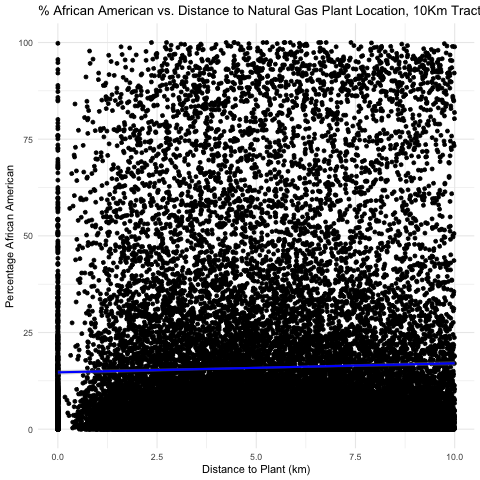

In [58]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_AFAM) +
    geom_point() +
    geom_smooth(method = "lm", color = "blue", se = TRUE,) +
          labs(
            title = "% African American vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage African American"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 345 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 345 rows containing missing values or values outside the scale range
(`geom_point()`). 



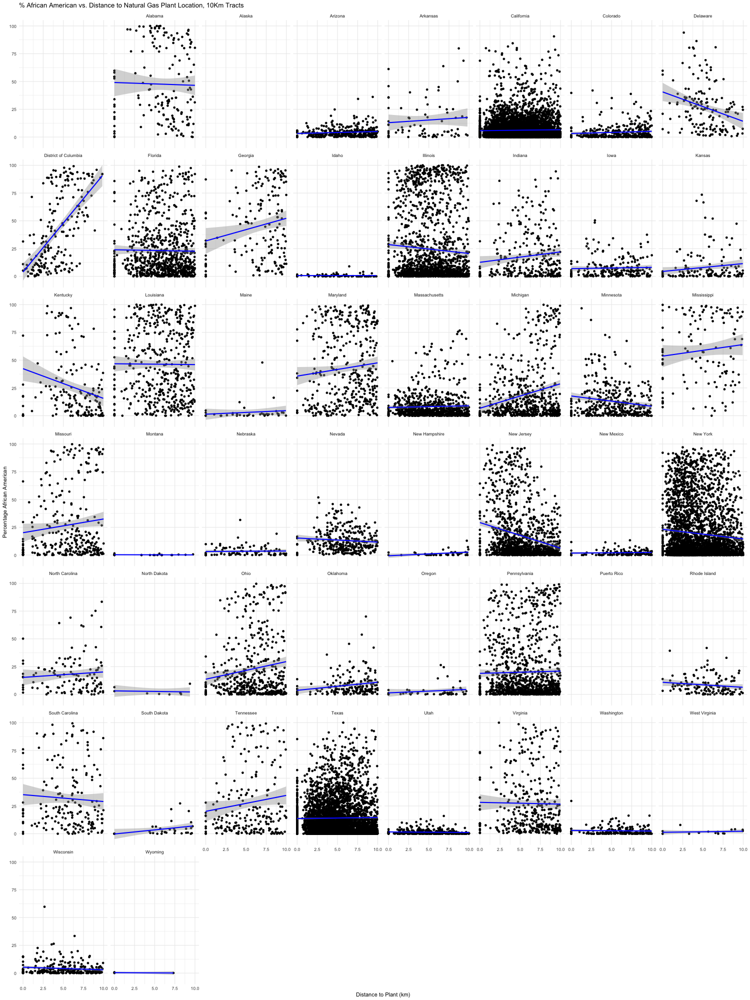

In [27]:
%%R -h 2000 -w 1500

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_AFAM) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", color = "blue", se = TRUE,) +
          labs(
            title = "% African American vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage African American"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 726 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 726 rows containing missing values or values outside the scale range
(`geom_point()`). 



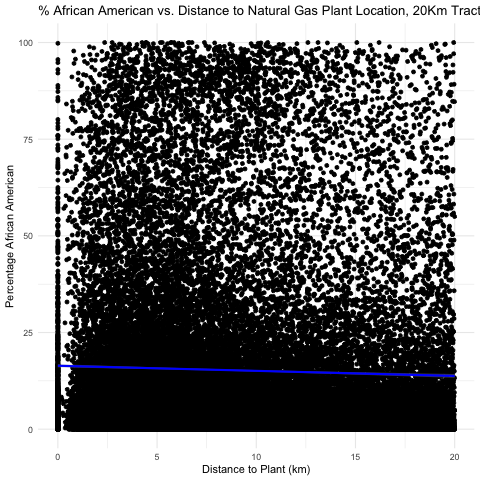

In [57]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_AFAM) +
    geom_point() +
    geom_smooth(method = "lm", color = "blue", se = TRUE,) +
          labs(
            title = "% African American vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage African American"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 726 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 726 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



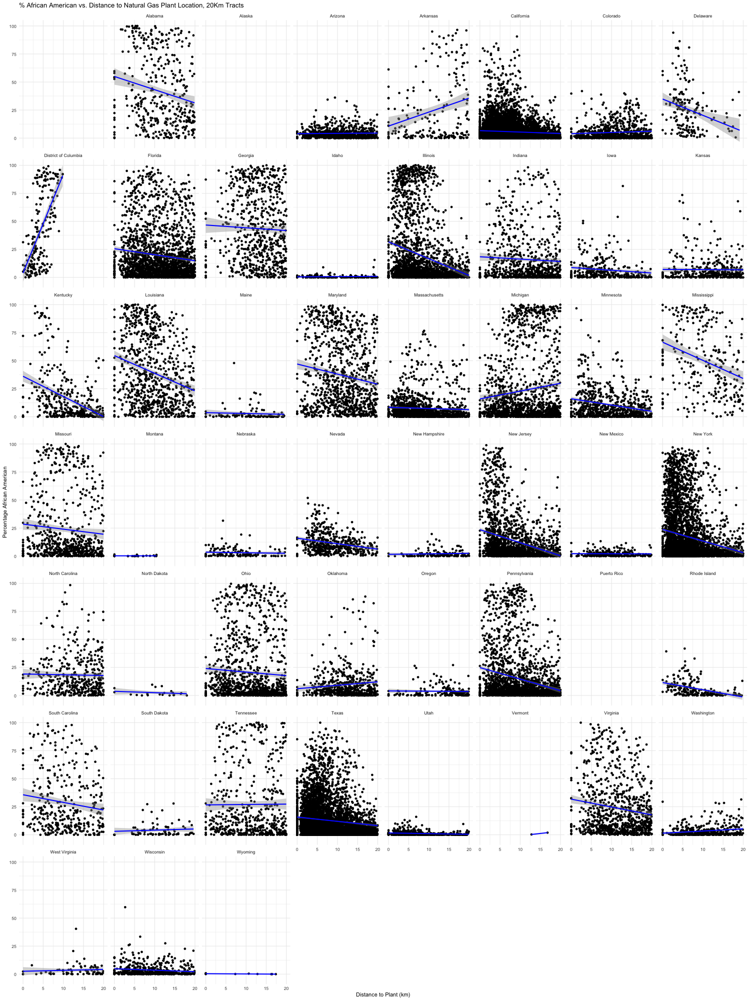

In [26]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_AFAM) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", color = "blue", se = TRUE,) +
          labs(
            title = "% African American vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage African American"
          ) +
          theme_minimal()

### The correlation with % African American and distance to plant depends on the state. In Alabama, Delaware, Florida, Illinois, Kentucky, Louisiana, Maryland, Minnesota, Mississippi, Missouri, Nevada, New Jersey, New York, Pennsylvania, Texas, South Carolina and Virginia there is a clear negative correlation within the 20km data. Other states are more flat or have a positive correlation, like Michigan and DC. However, as we can see above from the 10km correlation, this mainly only exists in the 20km data, meaning there is not too much correlation or an opposite correlation within 10km of plants, with a few exceptions like New Jersey.

## 3. % Hispanic and distance to plant location ##

In [63]:
%%R

model <- lm(distance_to_plant ~ E_HISP, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_HISP, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.1489 -0.9307  0.1572  1.1484  2.2142 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2.7797694  0.0179301 155.034  < 2e-16 ***
E_HISP      0.0036910  0.0004743   7.781 7.71e-15 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.399 on 13142 degrees of freedom
  (199 observations deleted due to missingness)
Multiple R-squared:  0.004586,	Adjusted R-squared:  0.00451 
F-statistic: 60.55 on 1 and 13142 DF,  p-value: 7.714e-15



In [64]:
%%R

model <- lm(distance_to_plant ~ E_HISP, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_HISP, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.3312 -2.0110  0.0002  2.0770  5.2221 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.3312064  0.0225572 236.342   <2e-16 ***
E_HISP      -0.0059316  0.0006169  -9.615   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.61 on 27436 degrees of freedom
  (345 observations deleted due to missingness)
Multiple R-squared:  0.003358,	Adjusted R-squared:  0.003322 
F-statistic: 92.44 on 1 and 27436 DF,  p-value: < 2.2e-16



In [65]:
%%R

model <- lm(distance_to_plant ~ E_HISP, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_HISP, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-9.7918 -4.0973 -0.7212  3.8825 14.3436 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  9.791761   0.033493  292.35   <2e-16 ***
E_HISP      -0.046434   0.001022  -45.44   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.186 on 44448 degrees of freedom
  (726 observations deleted due to missingness)
Multiple R-squared:  0.04439,	Adjusted R-squared:  0.04437 
F-statistic:  2065 on 1 and 44448 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 726 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 726 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



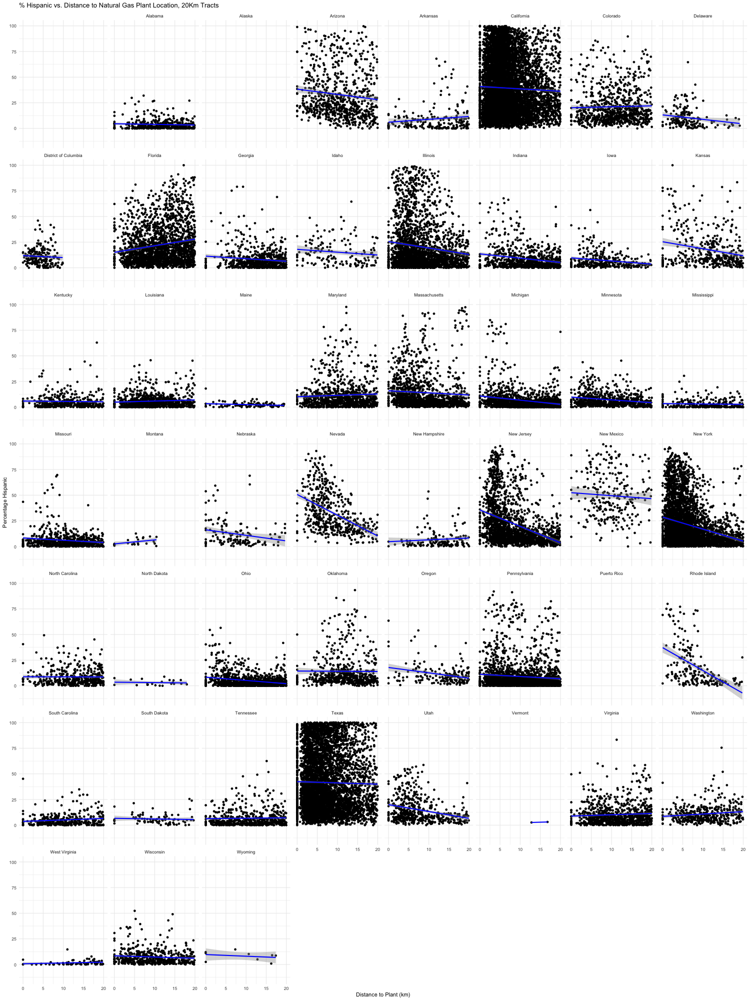

In [28]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_HISP) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", color = "blue", se = TRUE,) +
          labs(
            title = "% Hispanic vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage Hispanic"
          ) +
          theme_minimal()

### Explanation ###
The coefficient in the relationship between distance to a plant (x) and % African American population (y) is positive for the census tracts located within 5km. For the census tracts located within 10km and 20km of a power plant, it's negative – this would suggest that areas with higher percentages of Hispanic residents tend to be located slightly further from the plant. Looking at the data by state, it appears some states like Illinois, Arizona, New York and New Jersey have strong negative correlations between % Hispanic and distance to plant, while others are flat or positive, like Florida. Maryland is mostly flat, signifying no major correlation.

## 4. % Unemployed and distance to plant location ##

In [68]:
%%R

model <- lm(distance_to_plant ~ E_UNEMP, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_UNEMP, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.0196 -0.9307  0.1687  1.1495  2.1379 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2.857189   0.019872 143.782   <2e-16 ***
E_UNEMP     0.003913   0.002374   1.649   0.0993 .  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.401 on 13116 degrees of freedom
  (225 observations deleted due to missingness)
Multiple R-squared:  0.0002072,	Adjusted R-squared:  0.0001309 
F-statistic: 2.718 on 1 and 13116 DF,  p-value: 0.09926



In [69]:
%%R

model <- lm(distance_to_plant ~ E_UNEMP, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_UNEMP, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.2787 -2.0296 -0.0089  2.0894  5.2536 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.278730   0.025537 206.712  < 2e-16 ***
E_UNEMP     -0.015787   0.003118  -5.064 4.13e-07 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.612 on 27390 degrees of freedom
  (391 observations deleted due to missingness)
Multiple R-squared:  0.0009354,	Adjusted R-squared:  0.0008989 
F-statistic: 25.64 on 1 and 27390 DF,  p-value: 4.132e-07



In [70]:
%%R

model <- lm(distance_to_plant ~ E_UNEMP, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_UNEMP, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-9.4773 -4.2914 -0.8784  4.0012 14.2243 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  9.477321   0.039999  236.94   <2e-16 ***
E_UNEMP     -0.119120   0.005172  -23.03   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.272 on 44370 degrees of freedom
  (804 observations deleted due to missingness)
Multiple R-squared:  0.01181,	Adjusted R-squared:  0.01179 
F-statistic: 530.4 on 1 and 44370 DF,  p-value: < 2.2e-16



### Explanation ###
Same as with % African American and % Hispanic – % Unemployed increases in further away tracts. For tracts within 20km there is a hghly significant relationship (p value = 2.2e-16)

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 804 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 804 rows containing missing values or values outside the scale range
(`geom_point()`). 



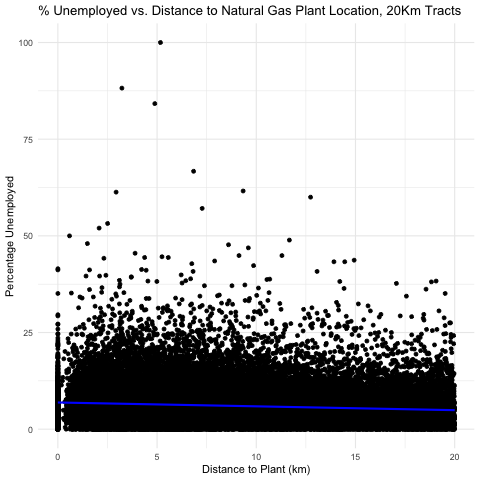

In [72]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_UNEMP) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Unemployed vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage Unemployed"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 804 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 804 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



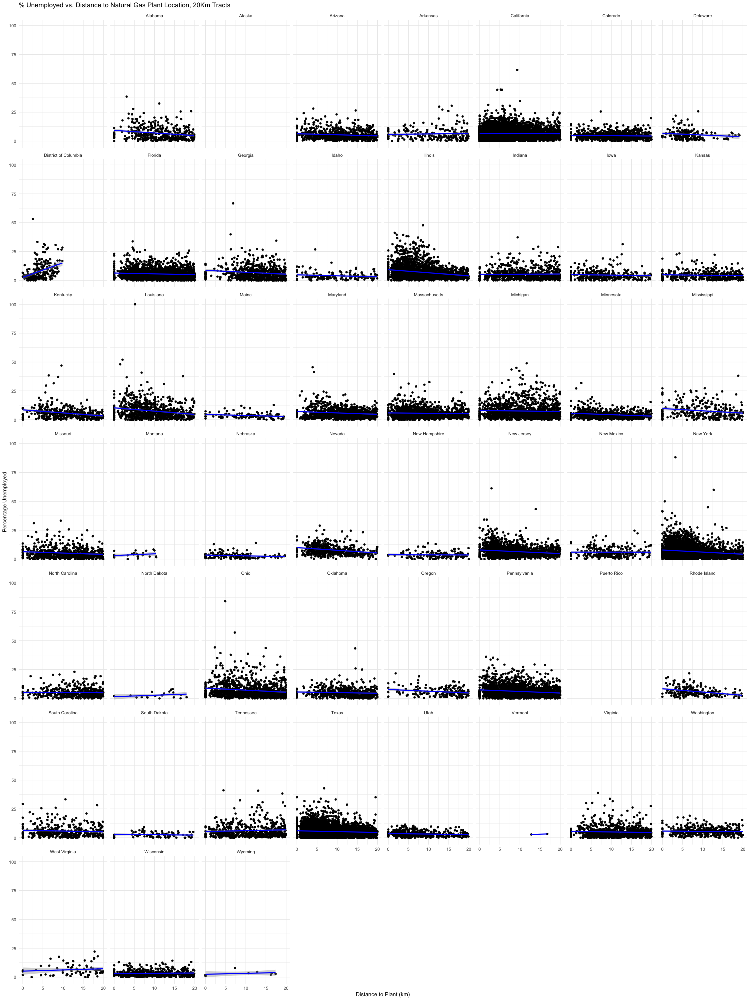

In [29]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_UNEMP) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Unemployed vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage Unemployed"
          ) +
          theme_minimal()

### The correlations are mainly flat. They are a bit stronger (negative) in Alabama, Illinois, Kentucky, and Louisiana.

## 5. % Unemployed and distance to plant location ##

In [83]:
%%R

model <- lm(distance_to_plant ~ E_NOHSDP, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_NOHSDP, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.1238 -0.9337  0.1698  1.1526  2.1549 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2.842791   0.018706 151.970  < 2e-16 ***
E_NOHSDP    0.002810   0.001002   2.804  0.00505 ** 
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.401 on 13134 degrees of freedom
  (207 observations deleted due to missingness)
Multiple R-squared:  0.0005984,	Adjusted R-squared:  0.0005223 
F-statistic: 7.864 on 1 and 13134 DF,  p-value: 0.005049



In [81]:
%%R

model <- lm(distance_to_plant ~ E_NOHSDP, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_NOHSDP, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.3139 -2.0245 -0.0087  2.0949  5.0391 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.313929   0.023972 221.668  < 2e-16 ***
E_NOHSDP    -0.009982   0.001314  -7.597 3.13e-14 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.611 on 27425 degrees of freedom
  (356 observations deleted due to missingness)
Multiple R-squared:  0.0021,	Adjusted R-squared:  0.002063 
F-statistic: 57.71 on 1 and 27425 DF,  p-value: 3.135e-14



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 356 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 356 rows containing missing values or values outside the scale range
(`geom_point()`). 



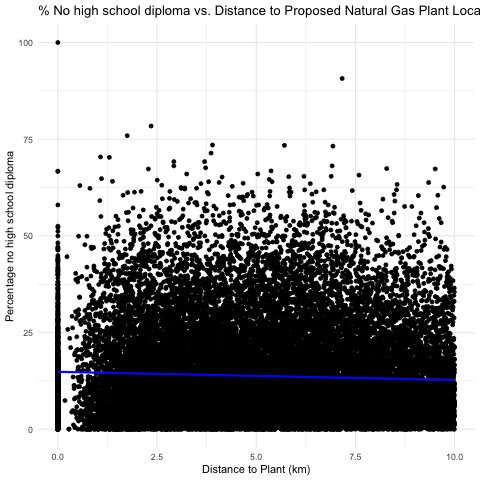

In [80]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_NOHSDP) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% No high school diploma vs. Distance to Proposed Natural Gas Plant Location, Tracts Within 10 Km",
            x = "Distance to Plant (km)",
            y = "Percentage no high school diploma"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 356 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 356 rows containing missing values or values outside the scale range
(`geom_point()`). 



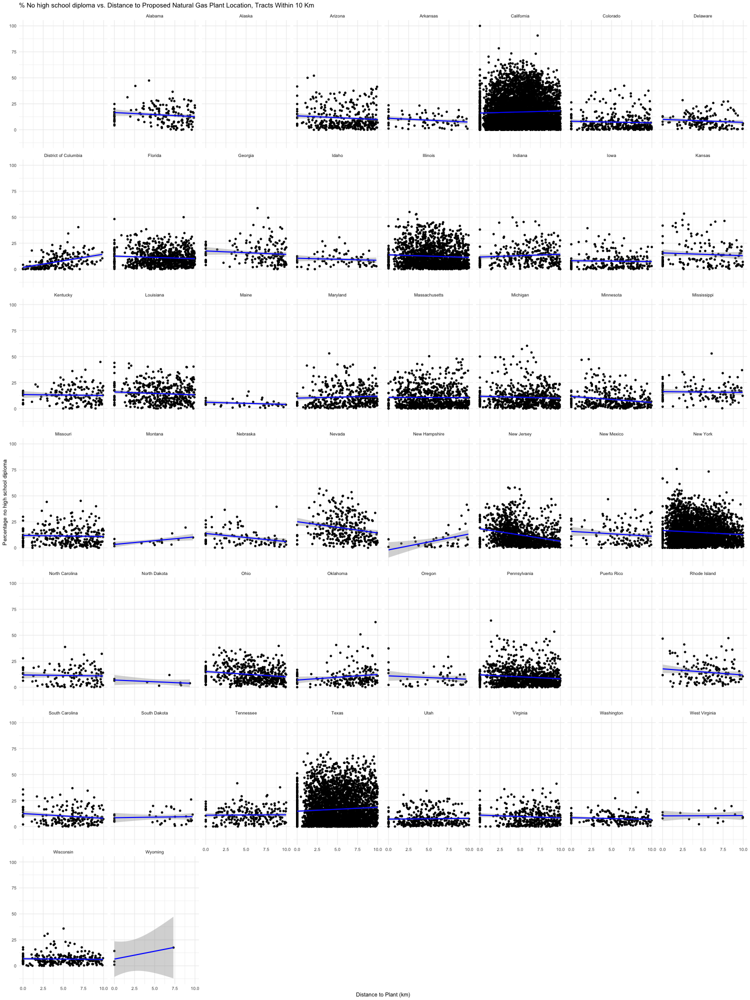

In [30]:
%%R -h 2000 -w 1500

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_NOHSDP) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% No high school diploma vs. Distance to Proposed Natural Gas Plant Location, Tracts Within 10 Km",
            x = "Distance to Plant (km)",
            y = "Percentage no high school diploma"
          ) +
          theme_minimal()

### Within 10km, only mainly the correlation in New Jersey appears strong with % of people without a high school diploma.

In [79]:
%%R

model <- lm(distance_to_plant ~ E_NOHSDP, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_NOHSDP, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-9.7873 -4.1894 -0.7342  3.8602 18.1913 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  9.787252   0.036691  266.75   <2e-16 ***
E_NOHSDP    -0.084524   0.002227  -37.96   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.221 on 44433 degrees of freedom
  (741 observations deleted due to missingness)
Multiple R-squared:  0.03141,	Adjusted R-squared:  0.03139 
F-statistic:  1441 on 1 and 44433 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 741 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 741 rows containing missing values or values outside the scale range
(`geom_point()`). 



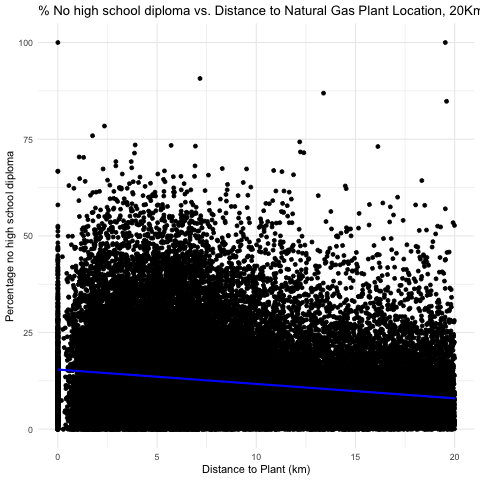

In [84]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_NOHSDP) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% No high school diploma vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage no high school diploma"
          ) +
          theme_minimal()

### Explanation ###
The correlation between % unemployed is strongest for tracts located within 20km of the plant - this means education level is the second strongest predictor of plant proximity - plants tend to be located in broader regions with lower educational attainment.

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 741 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 741 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



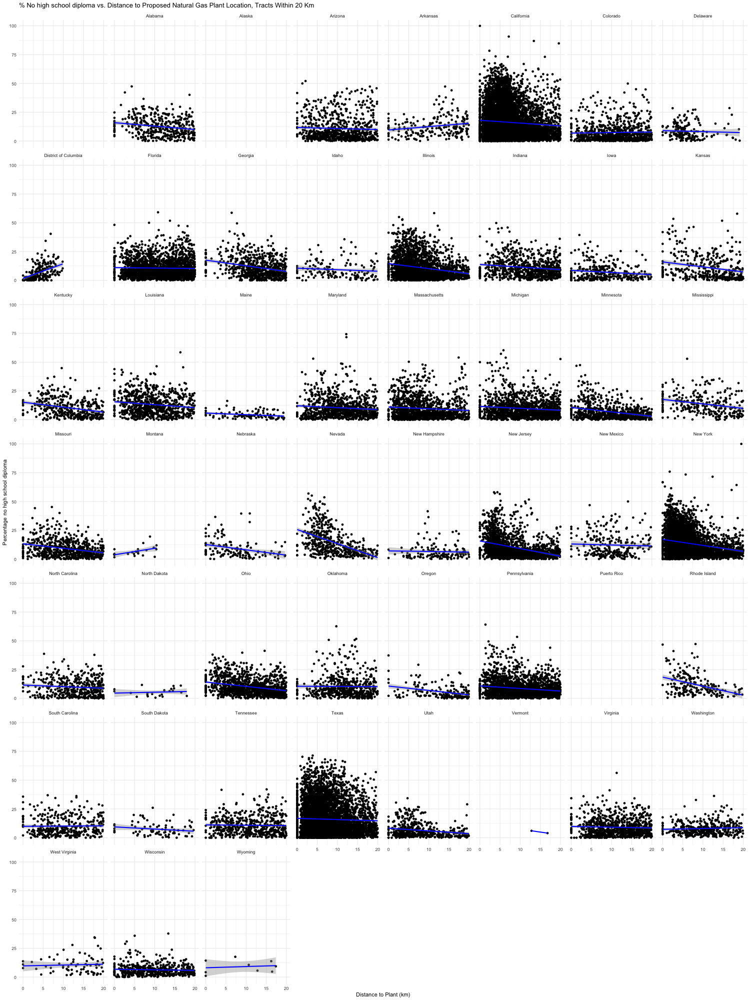

In [31]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_NOHSDP) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% No high school diploma vs. Distance to Proposed Natural Gas Plant Location, Tracts Within 20 Km",
            x = "Distance to Plant (km)",
            y = "Percentage no high school diploma"
          ) +
          theme_minimal()

### Within 20km, the strongest correlations with educational attainment are in Illinois, Minnesota, Nevada, New Jersey, New York and Ohio

## 6. % Uninsured and distance to plant location ##

In [86]:
%%R

model <- lm(distance_to_plant ~ E_UNINSUR, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_UNINSUR, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.1036 -0.9312  0.1710  1.1546  2.1471 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2.838621   0.018328 154.878  < 2e-16 ***
E_UNINSUR   0.004641   0.001434   3.237  0.00121 ** 
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.401 on 13115 degrees of freedom
  (226 observations deleted due to missingness)
Multiple R-squared:  0.0007982,	Adjusted R-squared:  0.000722 
F-statistic: 10.48 on 1 and 13115 DF,  p-value: 0.001212



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 226 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 226 rows containing missing values or values outside the scale range
(`geom_point()`). 



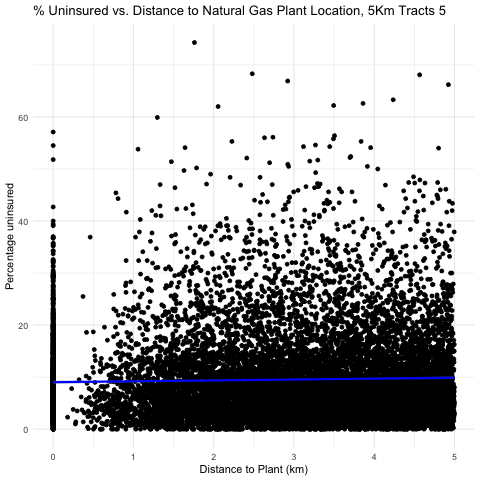

In [87]:
%%R

    ggplot(df_acc_5_km) +
    aes(x=distance_to_plant, y=E_UNINSUR) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Uninsured vs. Distance to Natural Gas Plant Location, 5Km Tracts 5",
            x = "Distance to Plant (km)",
            y = "Percentage uninsured"
          ) +
          theme_minimal()

In [88]:
%%R

model <- lm(distance_to_plant ~ E_UNINSUR, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_UNINSUR, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.2293 -2.0349 -0.0074  2.0902  4.9682 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.229333   0.023705 220.598  < 2e-16 ***
E_UNINSUR   -0.005556   0.001882  -2.951  0.00317 ** 
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.613 on 27391 degrees of freedom
  (390 observations deleted due to missingness)
Multiple R-squared:  0.0003179,	Adjusted R-squared:  0.0002814 
F-statistic: 8.711 on 1 and 27391 DF,  p-value: 0.003165



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 390 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 390 rows containing missing values or values outside the scale range
(`geom_point()`). 



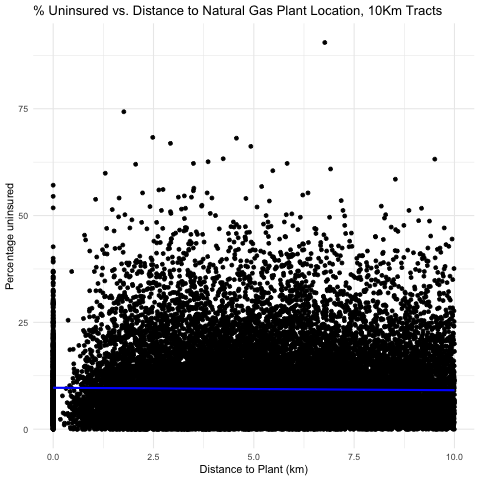

In [99]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_UNINSUR) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Uninsured vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage uninsured"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 390 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 390 rows containing missing values or values outside the scale range
(`geom_point()`). 



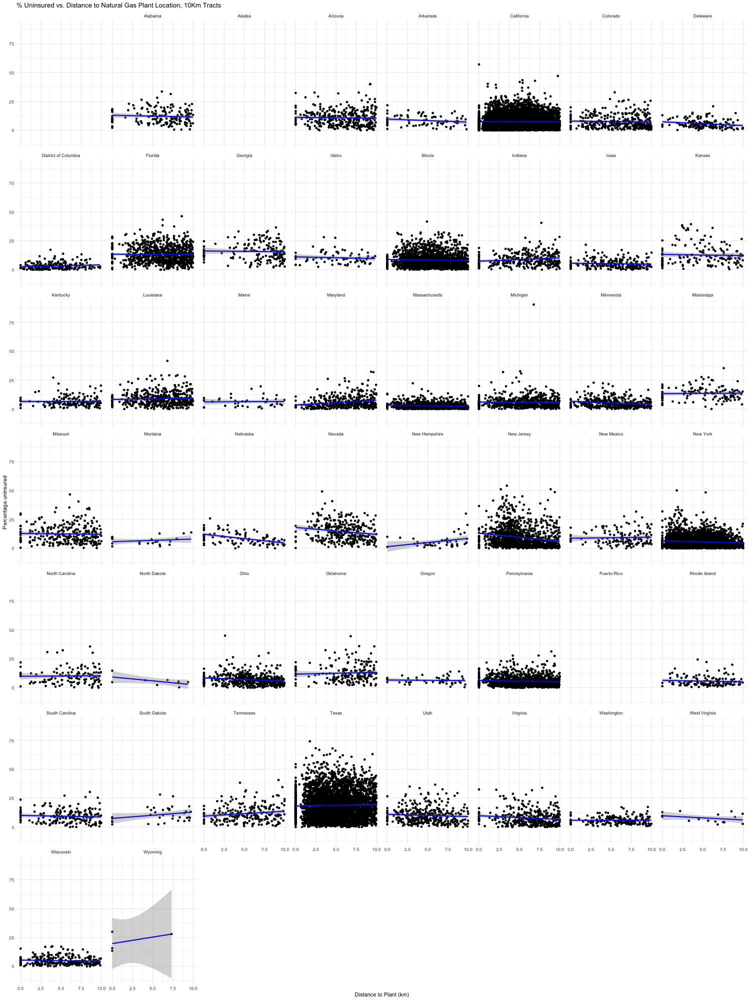

In [32]:
%%R -h 2000 -w 1500

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_UNINSUR) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Uninsured vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage uninsured"
          ) +
          theme_minimal()

### Within 10km, uninsured correlates most strongly with New Jersey and Nevada

In [90]:
%%R

model <- lm(distance_to_plant ~ E_UNINSUR, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_UNINSUR, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-9.2318 -4.2954 -0.8948  4.0240 12.4776 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  9.231772   0.037394  246.88   <2e-16 ***
E_UNINSUR   -0.053211   0.003121  -17.05   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.286 on 44375 degrees of freedom
  (799 observations deleted due to missingness)
Multiple R-squared:  0.006507,	Adjusted R-squared:  0.006485 
F-statistic: 290.7 on 1 and 44375 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 799 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 799 rows containing missing values or values outside the scale range
(`geom_point()`). 



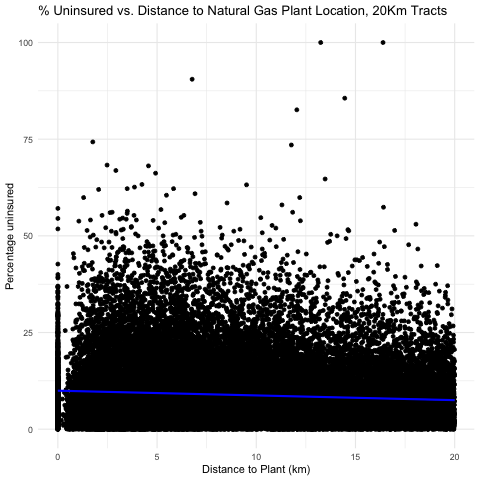

In [98]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_UNINSUR) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Uninsured vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage uninsured"
          ) +
          theme_minimal()

### Explanation ###
The correlation between % unemployed is strongest for tracts located within 20km of the plant - suggesting areas with higher percentages of uninsured populations tend to be located closer to industrial plants. Pattern not so visible for 5km and 10km tracts.

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 799 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 799 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



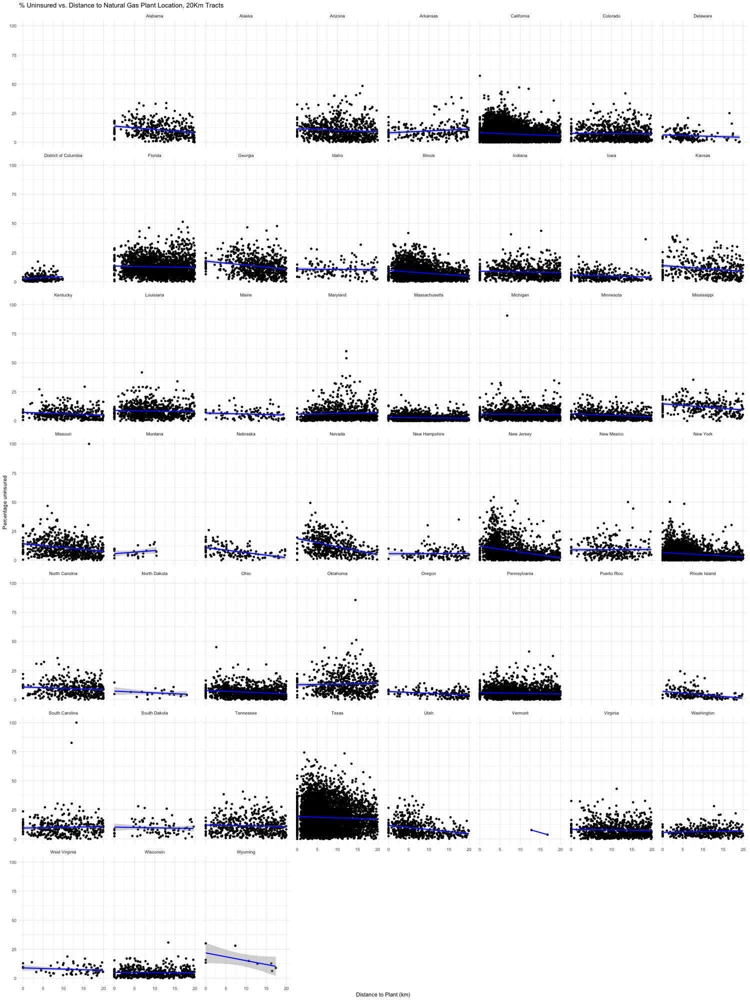

In [33]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_UNINSUR) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Uninsured vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage uninsured"
          ) +
          theme_minimal()

### The strongest correlations with % uninsured remain in New York and New Jersey, as well as Georgia, Illinois, Alabama, Kansas, Missouri, Nebraska, Rhode Island, Utah and Mississippi

## 7. Renters and distance to plant location ##

In [92]:
%%R

model <- lm(distance_to_plant ~ E_RENTER, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_RENTER, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.9901 -0.9199  0.1765  1.1473  2.1995 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.9901211  0.0262762 113.796  < 2e-16 ***
E_RENTER    -0.0020943  0.0004655  -4.499 6.88e-06 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.399 on 13081 degrees of freedom
  (260 observations deleted due to missingness)
Multiple R-squared:  0.001545,	Adjusted R-squared:  0.001469 
F-statistic: 20.24 on 1 and 13081 DF,  p-value: 6.884e-06



In [93]:
%%R

model <- lm(distance_to_plant ~ E_RENTER, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_RENTER, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-6.0811 -1.9452 -0.0023  2.0185  5.9142 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  6.0811313  0.0311699  195.10   <2e-16 ***
E_RENTER    -0.0199756  0.0005997  -33.31   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.561 on 27340 degrees of freedom
  (441 observations deleted due to missingness)
Multiple R-squared:  0.03899,	Adjusted R-squared:  0.03896 
F-statistic:  1109 on 1 and 27340 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 260 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 260 rows containing missing values or values outside the scale range
(`geom_point()`). 



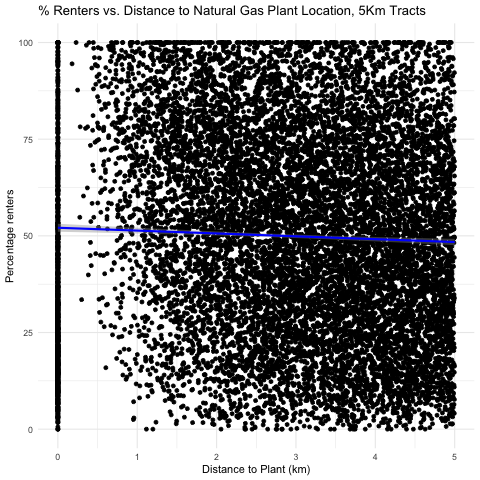

In [97]:
%%R

    ggplot(df_acc_5_km) +
    aes(x=distance_to_plant, y=E_RENTER) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Renters vs. Distance to Natural Gas Plant Location, 5Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage renters"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 260 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 260 rows containing missing values or values outside the scale range
(`geom_point()`). 



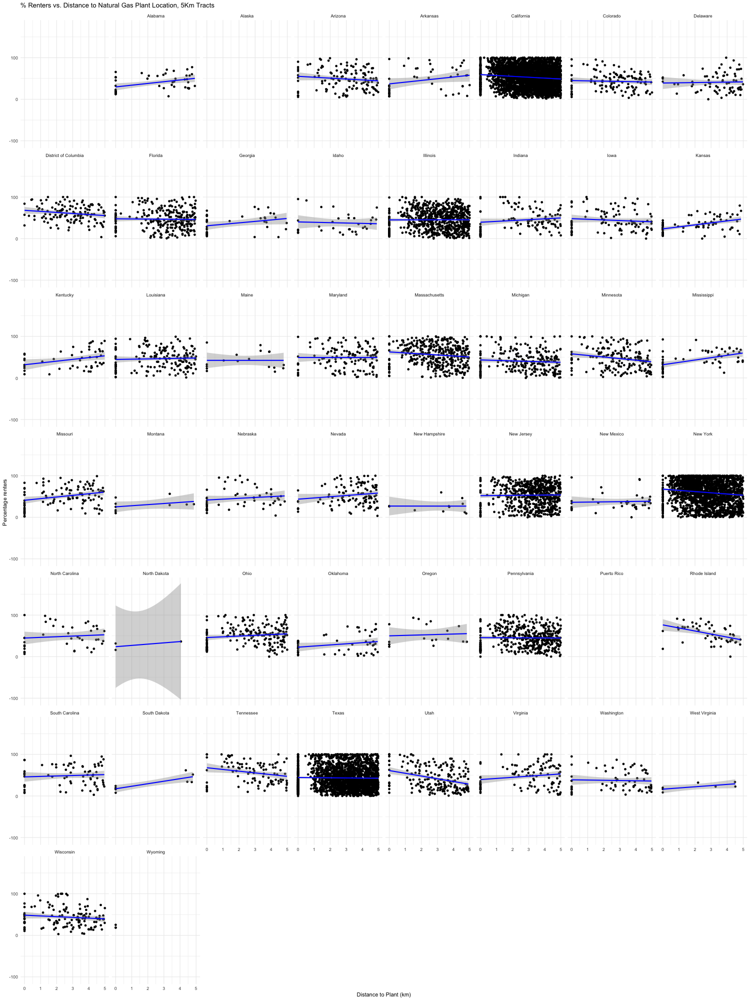

In [34]:
%%R -h 2000 -w 1500

    ggplot(df_acc_5_km) +
    aes(x=distance_to_plant, y=E_RENTER) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Renters vs. Distance to Natural Gas Plant Location, 5Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage renters"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 441 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 441 rows containing missing values or values outside the scale range
(`geom_point()`). 



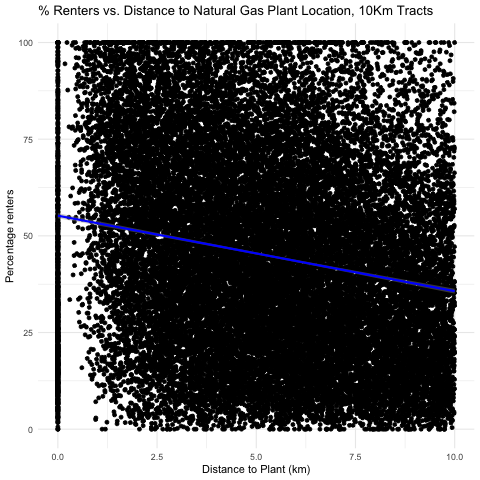

In [96]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_RENTER) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Renters vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage renters"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 441 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 441 rows containing missing values or values outside the scale range
(`geom_point()`). 



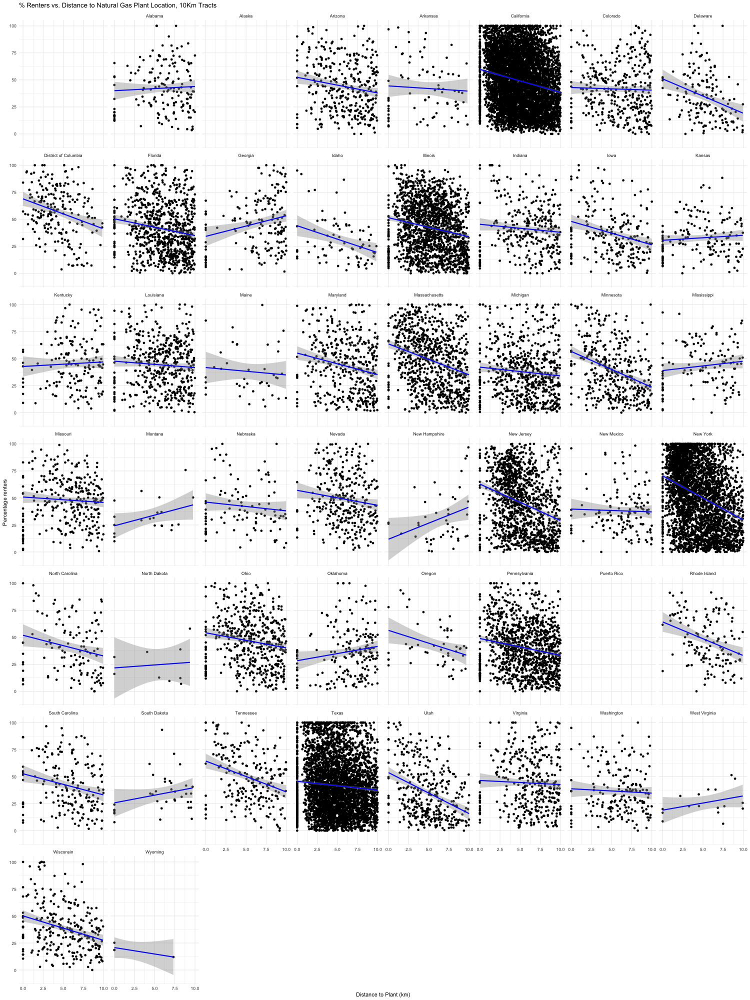

In [35]:
%%R -h 2000 -w 1500

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_RENTER) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Renters vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage renters"
          ) +
          theme_minimal()

In [100]:
%%R

model <- lm(distance_to_plant ~ E_RENTER, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_RENTER, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
-11.1484  -3.9520  -0.7738   3.7204  14.7481 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept) 11.1484457  0.0452363   246.4   <2e-16 ***
E_RENTER    -0.0593795  0.0009517   -62.4   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.084 on 44299 degrees of freedom
  (875 observations deleted due to missingness)
Multiple R-squared:  0.08078,	Adjusted R-squared:  0.08076 
F-statistic:  3893 on 1 and 44299 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 875 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 875 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



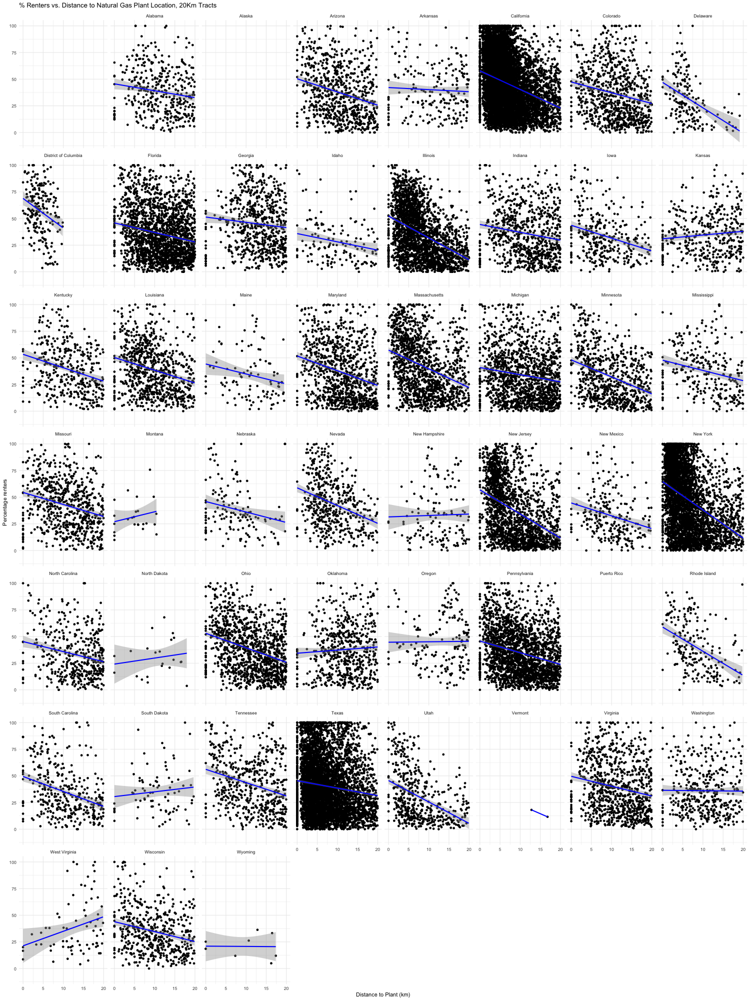

In [36]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_RENTER) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Renters vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage renters"
          ) +
          theme_minimal()

### There is a strong negative correlation with % renters in most states, other than Washington, Oregon, Oklahoma, New Hampshire

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 875 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 875 rows containing missing values or values outside the scale range
(`geom_point()`). 



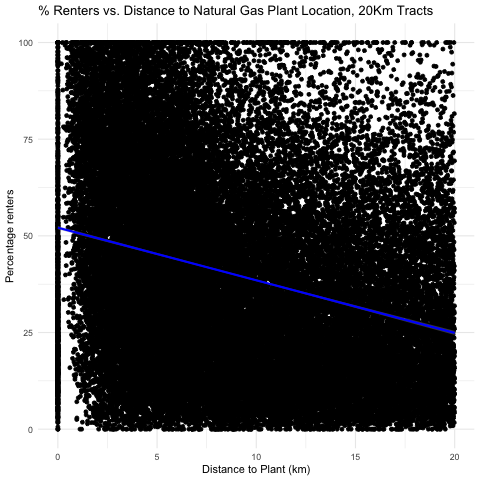

In [101]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_RENTER) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% Renters vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage renters"
          ) +
          theme_minimal()

### Explanation ###
Strongest relationship so far - areas with higher percentages of renters tend to be located closer to industrial plants

## 8. Impaired watershed and distance to plant location ##

In [109]:
%%R

model <- lm(distance_to_plant ~ E_IMPWTR, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_IMPWTR, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.9290 -0.9313  0.1673  1.1519  2.1999 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.79651    0.02425 115.311  < 2e-16 ***
E_IMPWTR     0.13245    0.03358   3.944 8.05e-05 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.402 on 13220 degrees of freedom
  (121 observations deleted due to missingness)
Multiple R-squared:  0.001175,	Adjusted R-squared:  0.0011 
F-statistic: 15.56 on 1 and 13220 DF,  p-value: 8.052e-05



In [110]:
%%R

model <- lm(distance_to_plant ~ E_IMPWTR, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_IMPWTR, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.4433 -2.0146  0.0008  2.0770  5.0096 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.44327    0.03016  180.50   <2e-16 ***
E_IMPWTR    -0.45395    0.04296  -10.57   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.61 on 27563 degrees of freedom
  (218 observations deleted due to missingness)
Multiple R-squared:  0.004035,	Adjusted R-squared:  0.003999 
F-statistic: 111.7 on 1 and 27563 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 218 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 218 rows containing missing values or values outside the scale range
(`geom_point()`). 



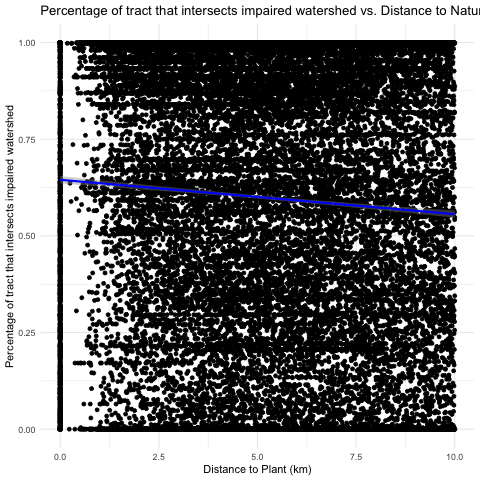

In [111]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_IMPWTR) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Percentage of tract that intersects impaired watershed vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of tract that intersects impaired watershed"
          ) +
          theme_minimal()

In [112]:
%%R

model <- lm(distance_to_plant ~ E_IMPWTR, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_IMPWTR, data = df_acc_20_km)

Residuals:
   Min     1Q Median     3Q    Max 
-9.616 -4.282 -0.917  4.021 11.888 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  9.61616    0.04602  208.97   <2e-16 ***
E_IMPWTR    -1.51426    0.06763  -22.39   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.276 on 44623 degrees of freedom
  (551 observations deleted due to missingness)
Multiple R-squared:  0.01111,	Adjusted R-squared:  0.01109 
F-statistic: 501.3 on 1 and 44623 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 551 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 551 rows containing missing values or values outside the scale range
(`geom_point()`). 



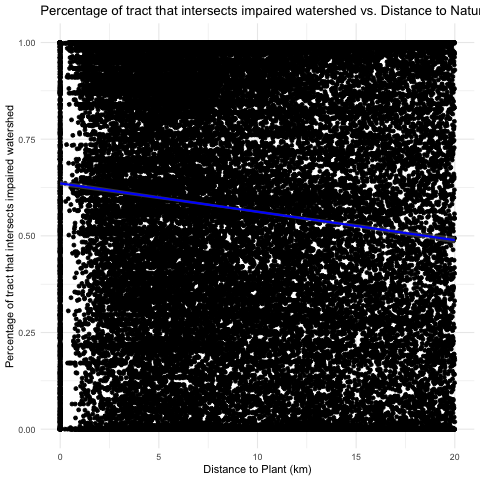

In [113]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_IMPWTR) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Percentage of tract that intersects impaired watershed vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of tract that intersects impaired watershed"
          ) +
          theme_minimal()

### Explanation ###
Significant relationship - areas closer to industrial plants tend to also cross an impaired watershed

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 551 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 551 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



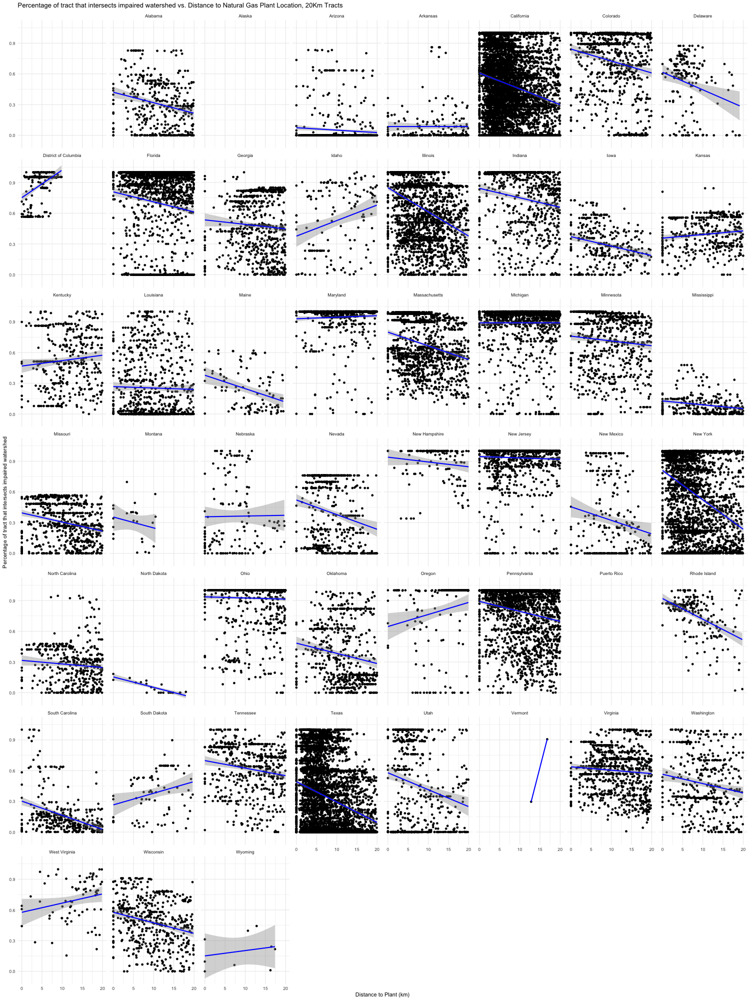

In [37]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_IMPWTR) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Percentage of tract that intersects impaired watershed vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of tract that intersects impaired watershed"
          ) +
          theme_minimal()

### In California, Alabama, Florida, Illinois, Iowa, Indiana, Massachusetts, New York, Pennsylvania, Oklahoma, Texas, Utah, Washington and Wisconsin there are strong negative relationships between impaired watersheds and distance to plants. In others, there are mostly flat relationships.

## 9. % Burdened by housing costs (households that make less than 75,000) and distance to plant location ##

In [114]:
%%R

model <- lm(distance_to_plant ~ E_HOUBDN, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_HOUBDN, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.0149 -0.9362  0.1664  1.1513  2.1587 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2.8262374  0.0301598  93.709   <2e-16 ***
E_HOUBDN    0.0018864  0.0008778   2.149   0.0316 *  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.399 on 13081 degrees of freedom
  (260 observations deleted due to missingness)
Multiple R-squared:  0.000353,	Adjusted R-squared:  0.0002765 
F-statistic: 4.619 on 1 and 13081 DF,  p-value: 0.03164



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 260 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 260 rows containing missing values or values outside the scale range
(`geom_point()`). 



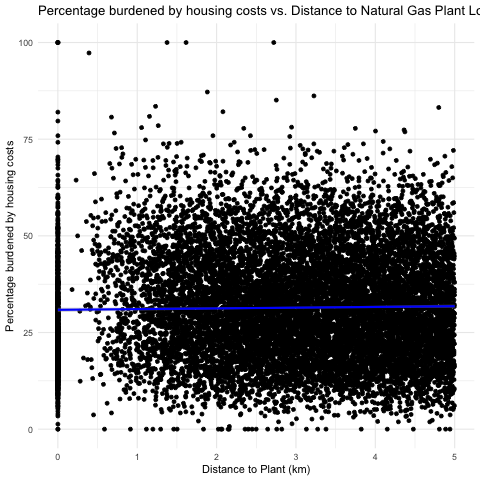

In [120]:
%%R

    ggplot(df_acc_5_km) +
    aes(x=distance_to_plant, y=E_HOUBDN) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Percentage burdened by housing costs vs. Distance to Natural Gas Plant Location, 5Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage burdened by housing costs"
          ) +
          theme_minimal()

In [115]:
%%R

model <- lm(distance_to_plant ~ E_HOUBDN, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_HOUBDN, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.6655 -2.0085 -0.0059  2.0824  5.3871 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.665509   0.038433  147.41   <2e-16 ***
E_HOUBDN    -0.016004   0.001156  -13.84   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.603 on 27340 degrees of freedom
  (441 observations deleted due to missingness)
Multiple R-squared:  0.00696,	Adjusted R-squared:  0.006924 
F-statistic: 191.6 on 1 and 27340 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 441 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 441 rows containing missing values or values outside the scale range
(`geom_point()`). 



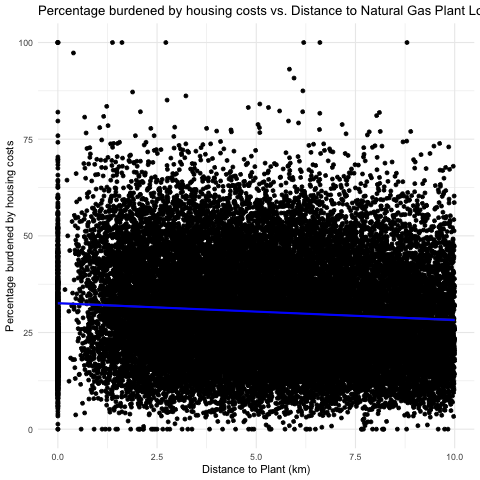

In [116]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_HOUBDN) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Percentage burdened by housing costs vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage burdened by housing costs"
          ) +
          theme_minimal()

In [117]:
%%R

model <- lm(distance_to_plant ~ E_HOUBDN, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_HOUBDN, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
-10.8885  -4.1504  -0.7984   3.9081  14.3025 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 10.888475   0.058599  185.81   <2e-16 ***
E_HOUBDN    -0.074617   0.001864  -40.03   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.209 on 44299 degrees of freedom
  (875 observations deleted due to missingness)
Multiple R-squared:  0.03492,	Adjusted R-squared:  0.0349 
F-statistic:  1603 on 1 and 44299 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 875 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 875 rows containing missing values or values outside the scale range
(`geom_point()`). 



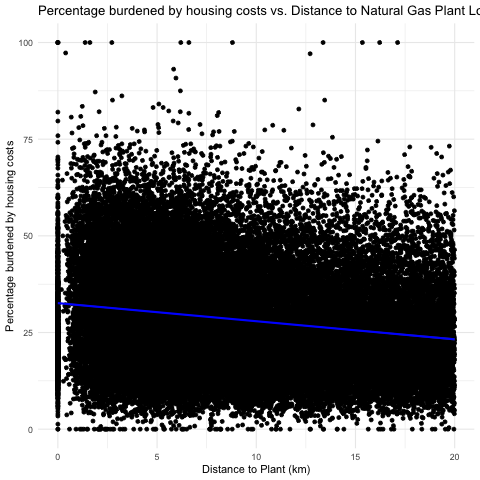

In [119]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_HOUBDN) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Percentage burdened by housing costs vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage burdened by housing costs"
          ) +
          theme_minimal()

### Explanation ###
Significant relationship at 10km and 20km between poverty markers and distance to power plant

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 875 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 875 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



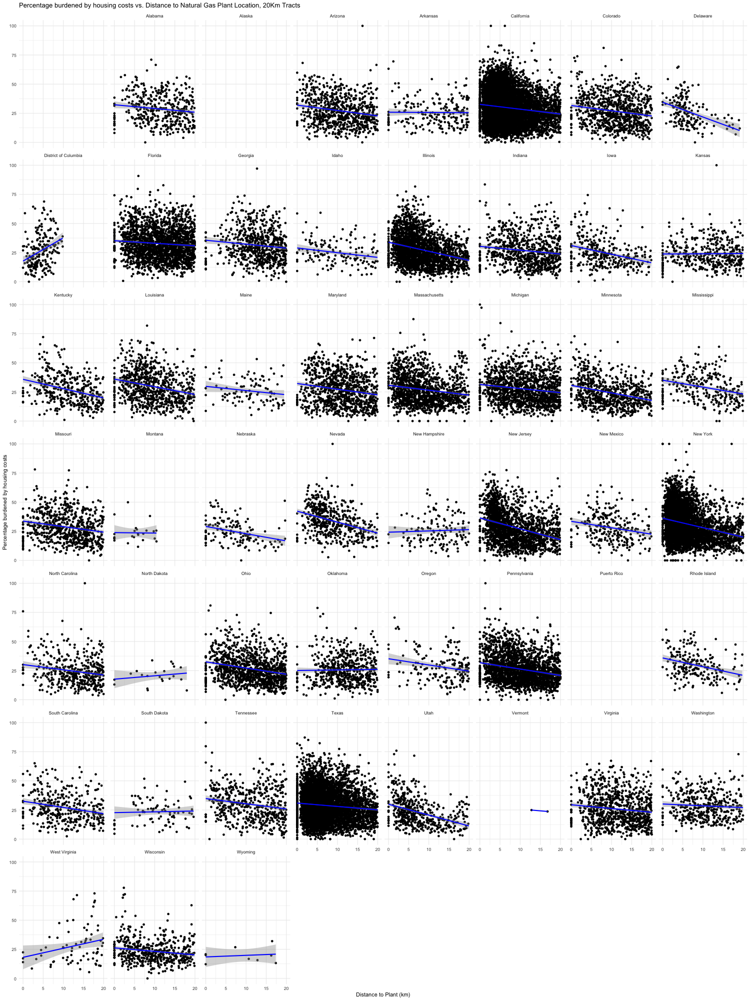

In [39]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_HOUBDN) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Percentage burdened by housing costs vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage burdened by housing costs"
          ) +
          theme_minimal()

### The negative correlation here with % burdened by housing costs is pretty consistent across states.

# Multivariate linear regressions

In [121]:
%%R

model <- lm(distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + E_UNINSUR + E_NOHSDP + E_LIMENG, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + 
    E_UNINSUR + E_NOHSDP + E_LIMENG, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4827 -0.9183  0.1602  1.1438  2.5156 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.9795618  0.0289959 102.758  < 2e-16 ***
E_POV200    -0.0043201  0.0009753  -4.430 9.52e-06 ***
E_AFAM       0.0063105  0.0006258  10.084  < 2e-16 ***
E_RENTER    -0.0032372  0.0005736  -5.644 1.70e-08 ***
E_UNINSUR    0.0024235  0.0017843   1.358    0.174    
E_NOHSDP    -0.0034905  0.0018981  -1.839    0.066 .  
E_LIMENG     0.0196943  0.0023985   8.211 2.40e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.39 on 13074 degrees of freedom
  (262 observations deleted due to missingness)
Multiple R-squared:  0.01445,	Adjusted R-squared:  0.014 
F-statistic: 31.94 on 6 and 13074 DF,  p-value: < 2.2e-16



In [122]:
%%R

model <- lm(distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + E_UNINSUR + E_NOHSDP + E_LIMENG, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + 
    E_UNINSUR + E_NOHSDP + E_LIMENG, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-6.6214 -1.9350 -0.0056  2.0185  6.2080 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.9512056  0.0344839 172.579  < 2e-16 ***
E_POV200     0.0035447  0.0013071   2.712  0.00669 ** 
E_AFAM       0.0077878  0.0007757  10.039  < 2e-16 ***
E_RENTER    -0.0232709  0.0007526 -30.922  < 2e-16 ***
E_UNINSUR    0.0065495  0.0023255   2.816  0.00486 ** 
E_NOHSDP    -0.0004732  0.0024382  -0.194  0.84611    
E_LIMENG    -0.0020989  0.0031262  -0.671  0.50199    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.552 on 27332 degrees of freedom
  (444 observations deleted due to missingness)
Multiple R-squared:  0.04566,	Adjusted R-squared:  0.04545 
F-statistic: 217.9 on 6 and 27332 DF,  p-value: < 2.2e-16



In [123]:
%%R

model <- lm(distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + E_UNINSUR + E_NOHSDP + E_LIMENG, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + 
    E_UNINSUR + E_NOHSDP + E_LIMENG, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
-11.8514  -3.8734  -0.6285   3.6250  16.6950 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  1.095e+01  5.010e-02 218.495   <2e-16 ***
E_POV200     2.539e-02  2.118e-03  11.984   <2e-16 ***
E_AFAM       4.839e-05  1.215e-03   0.040    0.968    
E_RENTER    -5.916e-02  1.206e-03 -49.056   <2e-16 ***
E_UNINSUR    4.197e-02  3.812e-03  11.009   <2e-16 ***
E_NOHSDP    -3.921e-02  4.054e-03  -9.673   <2e-16 ***
E_LIMENG    -8.923e-02  5.249e-03 -17.000   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.017 on 44291 degrees of freedom
  (878 observations deleted due to missingness)
Multiple R-squared:  0.1048,	Adjusted R-squared:  0.1047 
F-statistic: 864.4 on 6 and 44291 DF,  p-value: < 2.2e-16



### Explanation ###
The strongest finding is that areas with higher percentages of renters tend to be consistently closer to plants across all spatial scales, even after controlling for poverty, race, education, and other factors. Other results suggest complex spatial patterns - correlations are stronger for 10Km and 20Km tracts. Suggest demographics in 5Km tracts show other trends.

In [105]:
%%R

model <- lm(distance_to_plant ~ E_POV200 + E_AFAM + + E_UNEMP + E_RENTER + E_UNINSUR + E_NOHSDP + E_LIMENG + E_PARK + E_AGE17 + E_AGE65 + EPL_ROAD + E_HOUBDN + E_PM + E_OZONE, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200 + E_AFAM + +E_UNEMP + 
    E_RENTER + E_UNINSUR + E_NOHSDP + E_LIMENG + E_PARK + E_AGE17 + 
    E_AGE65 + EPL_ROAD + E_HOUBDN + E_PM + E_OZONE, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
-13.9564  -3.7209  -0.5897   3.4979  16.1066 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 11.546656   0.170093  67.884  < 2e-16 ***
E_POV200     0.010096   0.002492   4.051 5.10e-05 ***
E_AFAM       0.004378   0.001283   3.412 0.000646 ***
E_UNEMP     -0.050949   0.005741  -8.875  < 2e-16 ***
E_RENTER    -0.041415   0.001543 -26.832  < 2e-16 ***
E_UNINSUR    0.029131   0.003907   7.456 9.08e-14 ***
E_NOHSDP    -0.033897   0.004096  -8.275  < 2e-16 ***
E_LIMENG    -0.069309   0.005344 -12.970  < 2e-16 ***
E_PARK      -0.008693   0.001126  -7.721 1.17e-14 ***
E_AGE17      0.036495   0.003917   9.316  < 2e-16 ***
E_AGE65      0.043019   0.003467  12.407  < 2e-16 ***
EPL_ROAD    -3.6519

### Multivariate regressions looking at particulate matter and ozone ###

In [126]:
%%R

model <- lm(distance_to_plant ~ E_PM + E_OZONE, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_PM + E_OZONE, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-9.0506 -4.2980 -0.8444  4.0091 15.6998 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  9.050585   0.028150 321.507   <2e-16 ***
E_PM        -0.526205   0.028682 -18.347   <2e-16 ***
E_OZONE     -0.085770   0.009165  -9.359   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.273 on 44622 degrees of freedom
  (551 observations deleted due to missingness)
Multiple R-squared:  0.01207,	Adjusted R-squared:  0.01203 
F-statistic: 272.7 on 2 and 44622 DF,  p-value: < 2.2e-16



In [166]:
%%R

model <- lm(distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + E_LIMENG + E_AGE17 + EPL_ROAD + E_HOUBDN + E_PM + E_OZONE, data=df_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_POV200 + E_AFAM + E_RENTER + 
    E_LIMENG + E_AGE17 + EPL_ROAD + E_HOUBDN + E_PM + E_OZONE, 
    data = df_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4181 -0.8102  0.1149  0.9904  3.0170 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.875579   0.403424   2.170 0.030766 *  
E_POV200     -0.015192   0.007372  -2.061 0.040184 *  
E_AFAM        0.007021   0.002897   2.423 0.015969 *  
E_RENTER     -0.009965   0.004463  -2.233 0.026293 *  
E_LIMENG      0.020457   0.012873   1.589 0.113087    
E_AGE17       0.013464   0.011155   1.207 0.228385    
EPL_ROAD      2.825889   0.604271   4.677 4.42e-06 ***
E_HOUBDN      0.025161   0.010874   2.314 0.021349 *  
E_PM        -10.667110   2.767661  -3.854 0.000142 ***
E_OZONE       0.775669   0.304777   2.545 0.011429 *  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.306 on 299 degrees of freedom
  (1 

### Explanation ###
Areas with higher levels of air pollution (both particulate matter and ozone) tend to be located closer to plants at the 20km radius scale. This relationship is stronger for particulate matter than for ozone, suggesting that plants may be more strongly associated with PM emissions than with ozone formation.

### Asthma and distance to plant ###

In [127]:
%%R

model <- lm(distance_to_plant ~ E_ASTHMA, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_ASTHMA, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.9705 -0.9336  0.1748  1.1493  2.2161 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  3.087441   0.080721  38.248   <2e-16 ***
E_ASTHMA    -0.019827   0.007729  -2.565   0.0103 *  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.401 on 13117 degrees of freedom
  (224 observations deleted due to missingness)
Multiple R-squared:  0.0005015,	Adjusted R-squared:  0.0004253 
F-statistic: 6.582 on 1 and 13117 DF,  p-value: 0.01032



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 224 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 224 rows containing missing values or values outside the scale range
(`geom_point()`). 



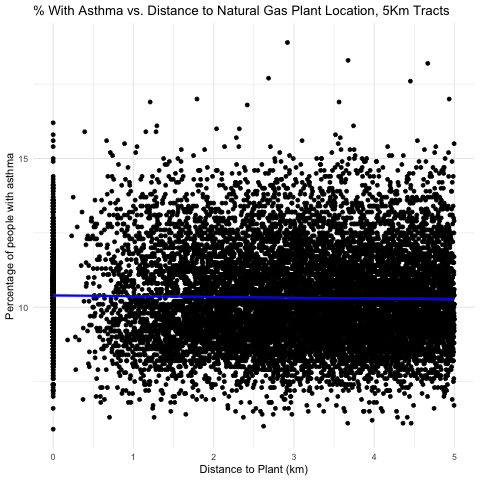

In [129]:
%%R

    ggplot(df_acc_5_km) +
    aes(x=distance_to_plant, y=E_ASTHMA) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% With Asthma vs. Distance to Natural Gas Plant Location, 5Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of people with asthma"
          ) +
          theme_minimal()

In [130]:
%%R

model <- lm(distance_to_plant ~ E_ASTHMA, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_ASTHMA, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.4872 -2.0271 -0.0022  2.0793  4.9399 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 4.624773   0.104838  44.114  < 2e-16 ***
E_ASTHMA    0.053236   0.009983   5.333 9.74e-08 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.613 on 27398 degrees of freedom
  (383 observations deleted due to missingness)
Multiple R-squared:  0.001037,	Adjusted R-squared:  0.001 
F-statistic: 28.44 on 1 and 27398 DF,  p-value: 9.743e-08



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 383 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 383 rows containing missing values or values outside the scale range
(`geom_point()`). 



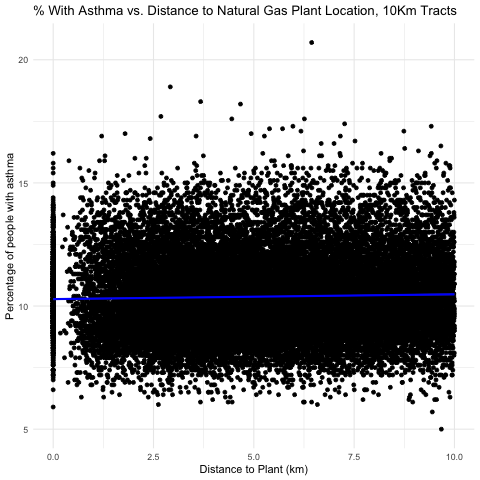

In [131]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_ASTHMA) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% With Asthma vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of people with asthma"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 383 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 383 rows containing missing values or values outside the scale range
(`geom_point()`). 



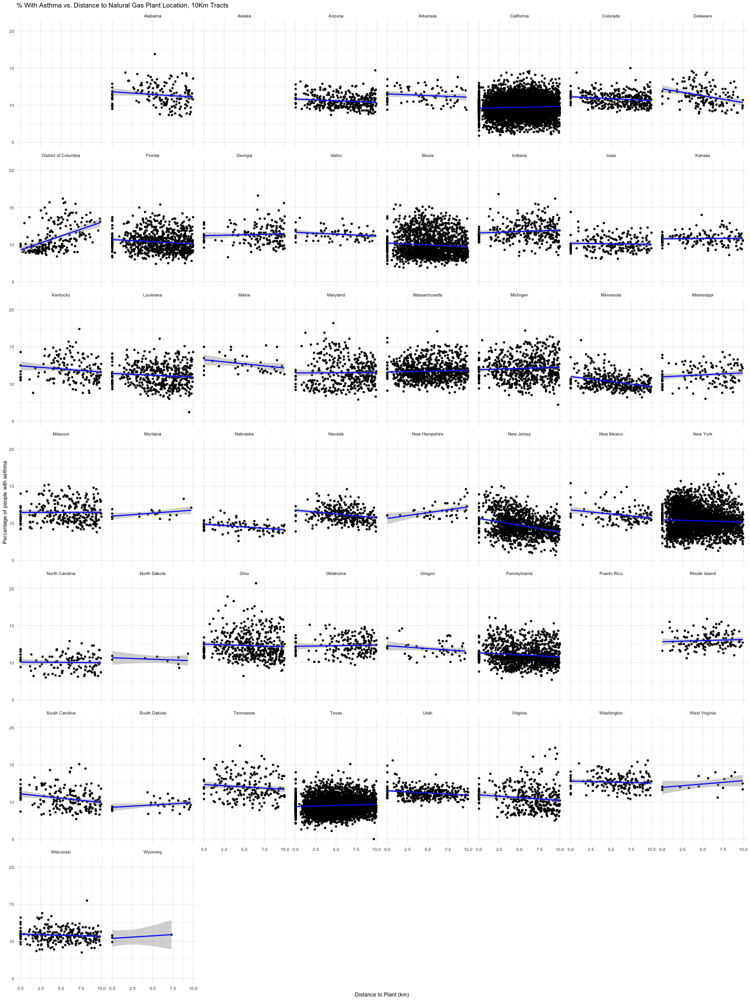

In [44]:
%%R -h 2000 -w 1500

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_ASTHMA) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% With Asthma vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of people with asthma"
          ) +
          theme_minimal()

In [132]:
%%R

model <- lm(distance_to_plant ~ E_ASTHMA, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_ASTHMA, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
 -9.9996  -4.3281  -0.9075   4.0698  11.8428 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  6.50978    0.17327   37.57   <2e-16 ***
E_ASTHMA     0.21542    0.01641   13.12   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.294 on 44390 degrees of freedom
  (784 observations deleted due to missingness)
Multiple R-squared:  0.003865,	Adjusted R-squared:  0.003843 
F-statistic: 172.2 on 1 and 44390 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 784 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 784 rows containing missing values or values outside the scale range
(`geom_point()`). 



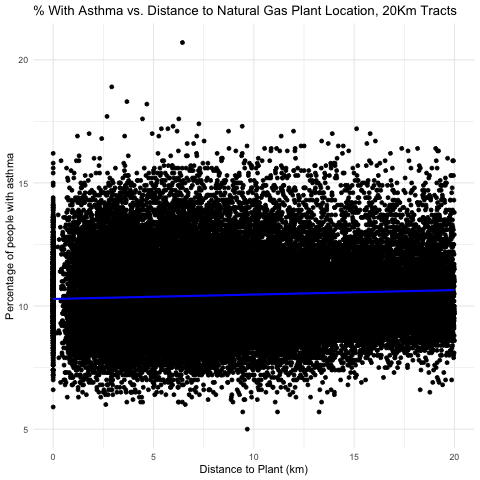

In [133]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_ASTHMA) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% With Asthma vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of people with asthma"
          ) +
          theme_minimal()

### Explanation ###
At the 5km scale, higher asthma rates are associated with closer proximity to plants. At larger distances (10km and 20km), higher asthma rates are associated with greater distance from plants.

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 784 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 784 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



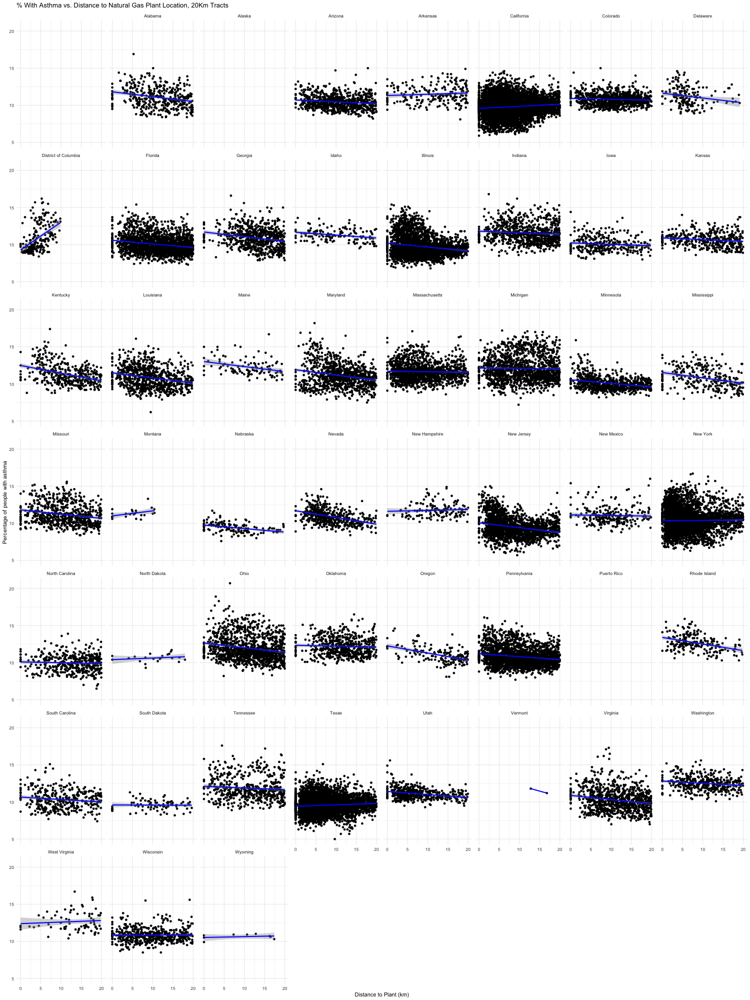

In [40]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_ASTHMA) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "% With Asthma vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "Percentage of people with asthma"
          ) +
          theme_minimal()

### Within 20km, Alabama, Arizona, Florida, Georgia, Illinois, Kansas, Kentucky, Louisiana, Maine, Maryland, Massachusetts, Minnesota, Mississippi, Missouri, Nevada, New Jersey, Ohio, Pennsylvania, Rhode Island, South Carolina and Virginia have higher asthma rates closer to plants. Others are flat or (in the case of California, which has most data points) positive. California may be skewing the national level trend above. It does look like Maryland has one of the stronger correlations between asthma rates and distance to plant, within the 20km data. However, this doesn't exist within 10km.

In [134]:
%%R

model <- lm(distance_to_plant ~ E_ASTHMA + E_POV200, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_ASTHMA + E_POV200, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.9589 -0.9255  0.1764  1.1437  2.2020 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.9942170  0.0903411  33.143   <2e-16 ***
E_ASTHMA    -0.0047926  0.0101650  -0.471    0.637    
E_POV200    -0.0017906  0.0008347  -2.145    0.032 *  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.4 on 13071 degrees of freedom
  (269 observations deleted due to missingness)
Multiple R-squared:  0.0008087,	Adjusted R-squared:  0.0006558 
F-statistic:  5.29 on 2 and 13071 DF,  p-value: 0.005055



In [135]:
%%R

model <- lm(distance_to_plant ~ E_ASTHMA + E_POV200, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_ASTHMA + E_POV200, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-6.6156 -1.9906 -0.0035  2.0592  5.6561 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  3.620474   0.115988   31.21   <2e-16 ***
E_ASTHMA     0.215140   0.012862   16.73   <2e-16 ***
E_POV200    -0.021005   0.001063  -19.77   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.592 on 27325 degrees of freedom
  (455 observations deleted due to missingness)
Multiple R-squared:  0.01513,	Adjusted R-squared:  0.01506 
F-statistic: 209.9 on 2 and 27325 DF,  p-value: < 2.2e-16



In [136]:
%%R

model <- lm(distance_to_plant ~ E_ASTHMA + E_POV200, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_ASTHMA + E_POV200, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
-14.2976  -4.0840  -0.7477   3.8199  15.0874 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.297172   0.188554   12.18   <2e-16 ***
E_ASTHMA     0.862000   0.020539   41.97   <2e-16 ***
E_POV200    -0.084176   0.001682  -50.06   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.148 on 44284 degrees of freedom
  (889 observations deleted due to missingness)
Multiple R-squared:  0.05727,	Adjusted R-squared:  0.05723 
F-statistic:  1345 on 2 and 44284 DF,  p-value: < 2.2e-16



### Explanation ###


In [158]:
%%R

model <- lm(distance_to_plant ~ E_PM, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_PM, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.2679 -0.9305  0.1722  1.1511  2.1393 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.85844    0.01365 209.446  < 2e-16 ***
E_PM         0.04360    0.01287   3.389 0.000704 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.403 on 13220 degrees of freedom
  (121 observations deleted due to missingness)
Multiple R-squared:  0.0008679,	Adjusted R-squared:  0.0007923 
F-statistic: 11.48 on 1 and 13220 DF,  p-value: 0.0007043



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 121 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 121 rows containing missing values or values outside the scale range
(`geom_point()`). 



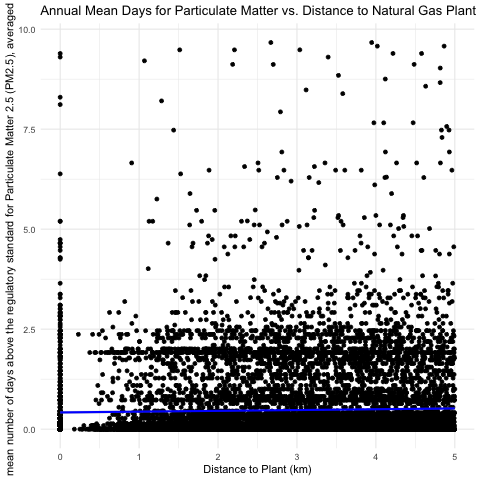

In [157]:
%%R

    ggplot(df_acc_5_km) +
    aes(x=distance_to_plant, y=E_PM) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Annual Mean Days for Particulate Matter vs. Distance to Natural Gas Plant Location, 5Km Tracts",
            x = "Distance to Plant (km)",
            y = "The annual mean number of days above the regulatory standard for Particulate Matter 2.5 (PM2.5), averaged over 3-years"
          ) +
          theme_minimal()

In [155]:
%%R

model <- lm(distance_to_plant ~ E_PM, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_PM, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.1845 -2.0377 -0.0087  2.0920  4.9854 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  5.18447    0.01748 296.574   <2e-16 ***
E_PM        -0.02830    0.01633  -1.733   0.0831 .  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.615 on 27563 degrees of freedom
  (218 observations deleted due to missingness)
Multiple R-squared:  0.0001089,	Adjusted R-squared:  7.265e-05 
F-statistic: 3.003 on 1 and 27563 DF,  p-value: 0.08313



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 218 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 218 rows containing missing values or values outside the scale range
(`geom_point()`). 



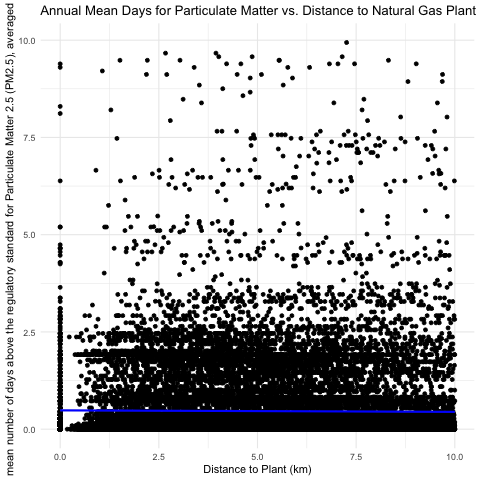

In [154]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_PM) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Annual Mean Days for Particulate Matter vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "The annual mean number of days above the regulatory standard for Particulate Matter 2.5 (PM2.5), averaged over 3-years"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 218 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 218 rows containing missing values or values outside the scale range
(`geom_point()`). 



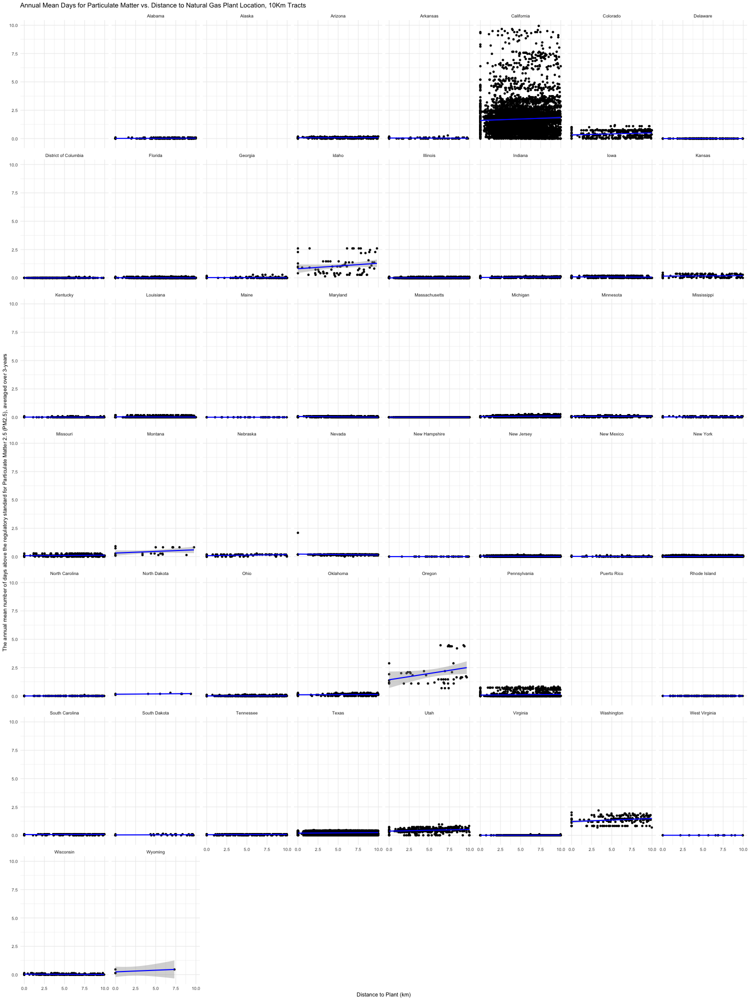

In [42]:
%%R -h 2000 -w 1500

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_PM) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Annual Mean Days for Particulate Matter vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "The annual mean number of days above the regulatory standard for Particulate Matter 2.5 (PM2.5), averaged over 3-years"
          ) +
          theme_minimal()

In [152]:
%%R

model <- lm(distance_to_plant ~ E_PM, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_PM, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-8.9842 -4.3076 -0.8555  4.0207 15.2152 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  8.98418    0.02727  329.48   <2e-16 ***
E_PM        -0.59383    0.02778  -21.37   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.278 on 44623 degrees of freedom
  (551 observations deleted due to missingness)
Multiple R-squared:  0.01013,	Adjusted R-squared:  0.01011 
F-statistic: 456.8 on 1 and 44623 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 551 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 551 rows containing missing values or values outside the scale range
(`geom_point()`). 



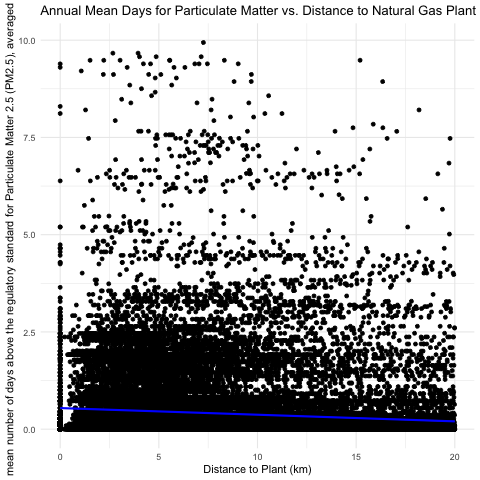

In [151]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_PM) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Annual Mean Days for Particulate Matter vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "The annual mean number of days above the regulatory standard for Particulate Matter 2.5 (PM2.5), averaged over 3-years"
          ) +
          theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 551 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: 
R[write to console]: In qt((1 - level)/2, df) :
R[write to console]:  NaNs produced

R[write to console]: 3: Removed 551 rows containing missing values or values outside the scale range
(`geom_point()`). 

R[write to console]: 4: 
R[write to console]: In max(ids, na.rm = TRUE) :
R[write to console]: 
 
R[write to console]:  no non-missing arguments to max; returning -Inf



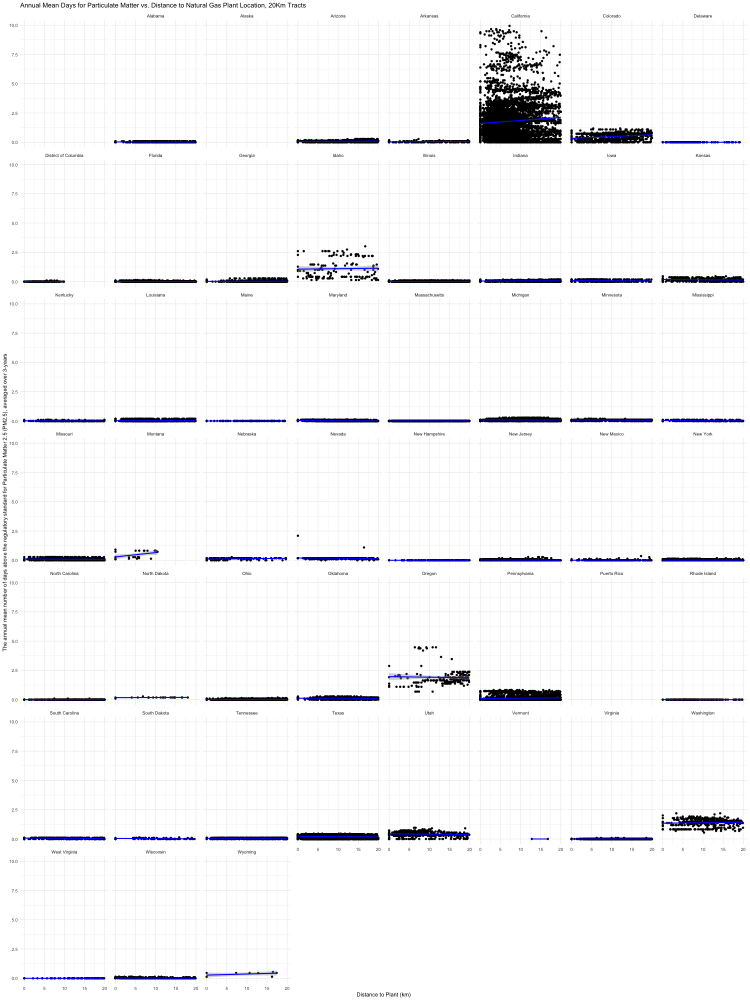

In [43]:
%%R -h 2000 -w 1500

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_PM) +
    geom_point() +
    facet_wrap(~StateDesc) +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Annual Mean Days for Particulate Matter vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "The annual mean number of days above the regulatory standard for Particulate Matter 2.5 (PM2.5), averaged over 3-years"
          ) +
          theme_minimal()

### Explanation ###


In [149]:
%%R

model <- lm(distance_to_plant ~ E_OZONE, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_OZONE, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.5072 -0.9272  0.1745  1.1468  2.1441 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2.852264   0.013115 217.478  < 2e-16 ***
E_OZONE     0.022504   0.004047   5.561 2.73e-08 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.402 on 13220 degrees of freedom
  (121 observations deleted due to missingness)
Multiple R-squared:  0.002334,	Adjusted R-squared:  0.002258 
F-statistic: 30.93 on 1 and 13220 DF,  p-value: 2.734e-08



In [148]:
%%R

model <- lm(distance_to_plant ~ E_OZONE, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_OZONE, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-5.5757 -2.0329 -0.0079  2.0901  4.8467 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 5.153324   0.016992 303.278   <2e-16 ***
E_OZONE     0.014515   0.005134   2.827   0.0047 ** 
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.615 on 27563 degrees of freedom
  (218 observations deleted due to missingness)
Multiple R-squared:  0.0002899,	Adjusted R-squared:  0.0002536 
F-statistic: 7.993 on 1 and 27563 DF,  p-value: 0.004701



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 218 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 218 rows containing missing values or values outside the scale range
(`geom_point()`). 



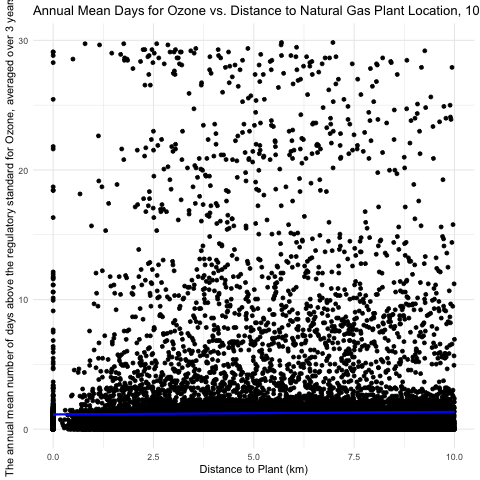

In [147]:
%%R

    ggplot(df_acc_10_km) +
    aes(x=distance_to_plant, y=E_OZONE) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Annual Mean Days for Ozone vs. Distance to Natural Gas Plant Location, 10Km Tracts",
            x = "Distance to Plant (km)",
            y = "The annual mean number of days above the regulatory standard for Ozone, averaged over 3 years"
          ) +
          theme_minimal()

In [145]:
%%R

model <- lm(distance_to_plant ~ E_OZONE, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_OZONE, data = df_acc_20_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-8.8897 -4.3398 -0.8749  4.0402 14.1277 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  8.889699   0.026850  331.09   <2e-16 ***
E_OZONE     -0.128130   0.008902  -14.39   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.293 on 44623 degrees of freedom
  (551 observations deleted due to missingness)
Multiple R-squared:  0.004621,	Adjusted R-squared:  0.004599 
F-statistic: 207.2 on 1 and 44623 DF,  p-value: < 2.2e-16



`geom_smooth()` using formula = 'y ~ x'


R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: Removed 551 rows containing non-finite outside the scale range
(`stat_smooth()`). 

R[write to console]: 2: Removed 551 rows containing missing values or values outside the scale range
(`geom_point()`). 



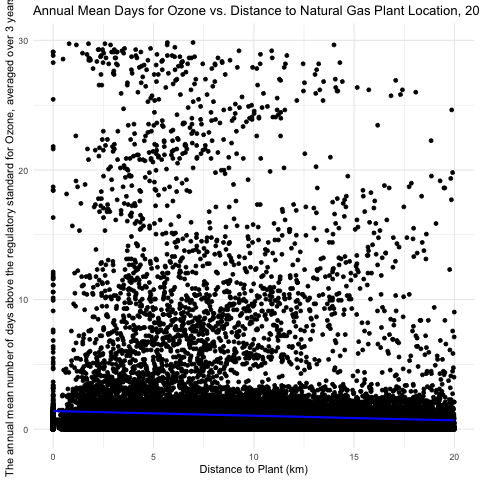

In [144]:
%%R

    ggplot(df_acc_20_km) +
    aes(x=distance_to_plant, y=E_OZONE) +
    geom_point() +
    geom_smooth(method = "lm", se = TRUE, color = "blue") +
          labs(
            title = "Annual Mean Days for Ozone vs. Distance to Natural Gas Plant Location, 20Km Tracts",
            x = "Distance to Plant (km)",
            y = "The annual mean number of days above the regulatory standard for Ozone, averaged over 3 years"
          ) +
          theme_minimal()

### Explanation ###


### Coronary heart disease ###

In [142]:
%%R

model <- lm(distance_to_plant ~ E_CHD, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_CHD, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.9349 -0.9338  0.1742  1.1519  2.1728 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.940703   0.038964  75.472   <2e-16 ***
E_CHD       -0.009617   0.006138  -1.567    0.117    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.402 on 13117 degrees of freedom
  (224 observations deleted due to missingness)
Multiple R-squared:  0.0001871,	Adjusted R-squared:  0.0001109 
F-statistic: 2.455 on 1 and 13117 DF,  p-value: 0.1172



In [141]:
%%R

model <- lm(distance_to_plant ~ E_CHD, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_CHD, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-6.5076 -2.0085  0.0019  2.0677  5.3949 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 4.356305   0.052211   83.44   <2e-16 ***
E_CHD       0.131981   0.008002   16.49   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.601 on 27398 degrees of freedom
  (383 observations deleted due to missingness)
Multiple R-squared:  0.009831,	Adjusted R-squared:  0.009795 
F-statistic:   272 on 1 and 27398 DF,  p-value: < 2.2e-16



In [140]:
%%R

model <- lm(distance_to_plant ~ E_CHD, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_CHD, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
-16.1640  -4.2147  -0.8918   4.0026  13.1950 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  6.09379    0.08336   73.10   <2e-16 ***
E_CHD        0.41439    0.01237   33.51   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.238 on 44390 degrees of freedom
  (784 observations deleted due to missingness)
Multiple R-squared:  0.02467,	Adjusted R-squared:  0.02465 
F-statistic:  1123 on 1 and 44390 DF,  p-value: < 2.2e-16



### Explanation ###


In [139]:
%%R

model <- lm(distance_to_plant ~ E_CANCER, data=df_acc_5_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_CANCER, data = df_acc_5_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-2.8910 -0.9344  0.1715  1.1539  2.1200 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.891838   0.035681  81.048   <2e-16 ***
E_CANCER    -0.001434   0.005288  -0.271    0.786    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.402 on 13117 degrees of freedom
  (224 observations deleted due to missingness)
Multiple R-squared:  5.609e-06,	Adjusted R-squared:  -7.063e-05 
F-statistic: 0.07358 on 1 and 13117 DF,  p-value: 0.7862



In [138]:
%%R

model <- lm(distance_to_plant ~ E_CANCER, data=df_acc_10_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_CANCER, data = df_acc_10_km)

Residuals:
    Min      1Q  Median      3Q     Max 
-6.6601 -1.9877  0.0168  2.0542  5.5785 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 4.107442   0.045919   89.45   <2e-16 ***
E_CANCER    0.160542   0.006479   24.78   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.585 on 27398 degrees of freedom
  (383 observations deleted due to missingness)
Multiple R-squared:  0.02192,	Adjusted R-squared:  0.02189 
F-statistic: 614.1 on 1 and 27398 DF,  p-value: < 2.2e-16



In [137]:
%%R

model <- lm(distance_to_plant ~ E_CANCER, data=df_acc_20_km)
summary(model)


Call:
lm(formula = distance_to_plant ~ E_CANCER, data = df_acc_20_km)

Residuals:
     Min       1Q   Median       3Q      Max 
-14.7653  -3.9730  -0.7572   3.7313  14.6774 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  4.60417    0.07176   64.16   <2e-16 ***
E_CANCER     0.57876    0.00941   61.50   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.091 on 44390 degrees of freedom
  (784 observations deleted due to missingness)
Multiple R-squared:  0.07852,	Adjusted R-squared:  0.0785 
F-statistic:  3783 on 1 and 44390 DF,  p-value: < 2.2e-16



### Explanation ###